<a href="https://colab.research.google.com/github/cosminconstantincostea/RL_cosmincostea/blob/Reinforcement-Learning/sPPO_Implementation_Optuna_2_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing libraries and dependencies.

In [ ]:
from google.colab import drive
from datetime import datetime

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip cache purge

Files removed: 0


In [ ]:
# TODO: update to install stable version from PyPi
!pip install --no-deps CityLearn==2.2.0
!pip install nrel-pysam

# Prove standard RL algorithms
!pip install stable-baselines3
!pip install tensorboard

# --- Library import ---
!pip install lz4
!pip install -U ray

# Otpuna
!pip install optuna

#! Plotly
!pip install Plotly

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 372.5/372.5 kB 23.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.3/47.3 MB 43.6 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
citylearn 2.2.0 requires doe-xstock>=1.0.0, which is not installed.
citylearn 2.2.0 requires openstudio<=3.3.0, which is not installed.
citylearn 2.2.0 requires numpy<2.0.0, but you have numpy 2.0.2 which is incompatible.
citylearn 2.2.0 requires scikit-learn<=1.2.2, but you have scikit-learn 1.6.1 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.0/188.0 kB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 53.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.4/72.4 MB 32.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 413.9/413.9 kB 25.0 MB/s eta 0:00:00


In [ ]:
# import the necessary pacakages

import gymnasium as gym
from gymnasium import spaces

import ray
from ray.tune.registry import register_env
from ray.rllib.algorithms.ppo import PPOConfig
from ray.rllib.env.multi_agent_env import MultiAgentEnv
from ray.rllib.algorithms.callbacks import DefaultCallbacks
from ray.rllib.algorithms.algorithm import Algorithm

# system operations
import inspect
import os
import uuid
import warnings

# date and time
import datetime

# type hinting
from typing import Any

# User interaction
from ipywidgets import Button, HTML
from ipywidgets import Text, HBox, VBox

# data visualization
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
from tqdm import tqdm

# data manipulation
from bs4 import BeautifulSoup
import math
import numpy as np
import pandas as pd
import random
import re
import requests
import simplejson as json

# cityLearn
from citylearn.agents.base import (
    BaselineAgent,
    Agent as RandomAgent
)
from citylearn.agents.rbc import HourRBC
from citylearn.agents.q_learning import TabularQLearning
from citylearn.citylearn import CityLearnEnv
from citylearn.data import DataSet
from citylearn.reward_function import RewardFunction
from citylearn.wrappers import (
    NormalizedObservationWrapper,
    StableBaselines3Wrapper,
    TabularQLearningWrapper,
    DiscreteObservationWrapper,
    DiscreteActionWrapper
)

# RL algorithms
from stable_baselines3 import SAC
from stable_baselines3 import PPO
from stable_baselines3 import DQN
from stable_baselines3 import DDPG


# Callbacks
from stable_baselines3.common.callbacks import CheckpointCallback
from stable_baselines3.common.callbacks import EvalCallback
from stable_baselines3.common.callbacks import CallbackList
from stable_baselines3.common.callbacks import StopTrainingOnRewardThreshold
from stable_baselines3.common.callbacks import BaseCallback

import time

import optuna
from absl import flags
from optuna.pruners import MedianPruner
from optuna.samplers import TPESampler
from optuna.visualization import plot_optimization_history, plot_param_importances, plot_parallel_coordinate
from stable_baselines3 import PPO
from stable_baselines3.common.callbacks import StopTrainingOnNoModelImprovement
from stable_baselines3.common.monitor import Monitor

import optuna

# You can use Matplotlib instead of Plotly for visualization by simply replacing `optuna.visualization` with
# `optuna.visualization.matplotlib` in the following examples.
from optuna.visualization.matplotlib import plot_contour
from optuna.visualization.matplotlib import plot_edf
from optuna.visualization.matplotlib import plot_intermediate_values
from optuna.visualization.matplotlib import plot_optimization_history
from optuna.visualization.matplotlib import plot_parallel_coordinate
from optuna.visualization.matplotlib import plot_param_importances
from optuna.visualization.matplotlib import plot_rank
from optuna.visualization.matplotlib import plot_slice
from optuna.visualization.matplotlib import plot_timeline


import shutil

Gym has been unmaintained since 2022 and does not support NumPy 2.0 amongst other critical functionality.
Please upgrade to Gymnasium, the maintained drop-in replacement of Gym, or contact the authors of your software and request that they upgrade.
See the migration guide at https://gymnasium.farama.org/introduction/migration_guide/ for additional information.
/usr/local/lib/python3.12/dist-packages/jupyter_client/session.py:203: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)


In [ ]:
# Global settings for the remainder of the note book

# All plotted figures without margins
plt.rcParams['axes.ymargin'] = 0
plt.rcParams['axes.xmargin'] = 0
%matplotlib inline

# ignore depractino warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [ ]:
display('All CityLearn datasets:', sorted(DataSet().get_dataset_names()))
DATASET_NAME = 'citylearn_challenge_2022_phase_all'

schema = DataSet().get_schema(DATASET_NAME)
root_directory = schema['root_directory']

INFO:root:The dataset names DNE in cache. Will download from intelligent-environments-lab/CityLearn/tree/v2.2.0 GitHub repository and write to /root/.cache/citylearn/v2.2.0/dataset_names.json. Next time DataSet.get_dataset_names is called, it will read from cache unless DataSet.clear_cache is run first.


'All CityLearn datasets:'

['baeda_3dem',
 'ca_alameda_county_neighborhood',
 'citylearn_challenge_2020_climate_zone_1',
 'citylearn_challenge_2020_climate_zone_2',
 'citylearn_challenge_2020_climate_zone_3',
 'citylearn_challenge_2020_climate_zone_4',
 'citylearn_challenge_2021',
 'citylearn_challenge_2022_phase_1',
 'citylearn_challenge_2022_phase_2',
 'citylearn_challenge_2022_phase_3',
 'citylearn_challenge_2022_phase_all',
 'citylearn_challenge_2022_phase_all_plus_evs',
 'citylearn_challenge_2023_phase_1',
 'citylearn_challenge_2023_phase_2_local_evaluation',
 'citylearn_challenge_2023_phase_2_online_evaluation_1',
 'citylearn_challenge_2023_phase_2_online_evaluation_2',
 'citylearn_challenge_2023_phase_2_online_evaluation_3',
 'citylearn_challenge_2023_phase_3_1',
 'citylearn_challenge_2023_phase_3_2',
 'citylearn_challenge_2023_phase_3_3',
 'quebec_neighborhood_with_demand_response_set_points',
 'quebec_neighborhood_without_demand_response_set_points',
 'tx_travis_county_neighborhood',
 'vt_chittenden_cou

INFO:root:The citylearn_challenge_2022_phase_all dataset DNE in cache. Will download from intelligent-environments-lab/CityLearn/tree/v2.2.0 GitHub repository and write to /root/.cache/citylearn/v2.2.0/datasets. Next time DataSet.get_dataset('citylearn_challenge_2022_phase_all') is called, it will read from cache unless DataSet.clear_cache is run first.


# Building selection and Simulation period selection

In [ ]:
def select_buildings(
dataset_name: str, count: int, seed: int, buildings_to_exclude: list[str] = None,
) -> list[str]:
    """ Randoms elect buildings from Citylearn dataset.

    Parameters
    ----------
    dataset_name = str
        CityLearn dataset to query buildings from.
    count: int
        Number of buildings to set as active in schema.
    seed: int
        Seed for pseudo-random number generator
    building_to_exclude: list[str]
        List of buildings to exclude from selection pool

    Returns
    -------
    buildings: list[str]
    """

    assert 1 <= count <= 15, 'count must be between 1 and 15'

    # set random seed
    np.random.seed(seed)

    # get all bulding names
    schema = DataSet().get_schema(dataset_name)
    buildings = list(schema['buildings'].keys())

    # remove buildings 12 and 15 as they have peculiarities in thei data
    # that are no relevant for this application
    buildings_to_exclude = [] if buildings_to_exclude is None \
        else [b for b in buildings_to_exclude]
    buildings_to_exclude += ['Building_12', 'Building_15']

    for b in buildings_to_exclude:
        if b in buildings:
            buildings.remove(b)

    # randomly select specified number of buildings
    buildings = np.random.choice(buildings, count, replace=False)

    return buildings.tolist()

In [ ]:
def select_simulation_period(
    dataset_name: str, count: int, seed: int,
    simulation_periods_to_exclude: list[tuple[int, int]] = None
) -> tuple[int, int]:
    """Randomly select environment simulation start and end time steps
    that cover a specified number of days.

    Parameters
    ----------
    dataset_name: str
        CityLearn dataset to query buildings from.
    count: int
        Number of simulation days.
    seed: int
        Seed for pseudo-random number generator.
    simulation_periods_to_exclude: list[tuple[int, int]]
        List of simulation periods to exclude from selection pool.

    Returns
    -------
    simulation_start_time_step: int
        The first time step in schema time series files to
        be read when constructing the environment.
    simulation_end_time_step: int
        The last time step in schema time series files to
        be read when constructing the environment.
    """

    assert 1 <= count <= 365, 'count must be between 1 and 365.'

    # set random seed
    np.random.seed(seed)

    # use any of the files to determine the total
    # number of available time steps
    schema = DataSet().get_schema(dataset_name)
    filename = schema['buildings'][building_name]['carbon_intensity']
    filepath = os.path.join(root_directory, filename)
    time_steps = pd.read_csv(filepath).shape[0]

    # set candidate simulation start time steps
    # spaced by the number of specified days
    simulation_start_time_step_list = np.arange(0, time_steps, 24*count)

    # exclude period if needed
    if simulation_periods_to_exclude is not None:
        simulation_start_time_step_list_to_exclude = \
            [s for s, e in simulation_periods_to_exclude]
        simulation_start_time_step_list = np.setdiff1d(
            simulation_start_time_step_list,
            simulation_start_time_step_list_to_exclude
        )

    else:
        pass

    # randomly select a simulation start time step
    simulation_start_time_step = np.random.choice(
        simulation_start_time_step_list, size=1
    )[0]
    simulation_end_time_step = simulation_start_time_step + 24*count - 1

    # Split for testing and training
    # 70% testing
    # 30% training
    training_days = int(count*0.7)
    print("Training days:", training_days)
    testing_days = int(count*0.3)
    print("Testing days:", testing_days)

    training_time_steps = training_days*24
    print("Training time steps:", training_time_steps)
    testing_time_steps = testing_days*24
    print("Testing time steps:", testing_time_steps)

    training_start_time_step = simulation_start_time_step
    training_end_time_step   = simulation_start_time_step + training_time_steps -1

    testing_start_time_step = training_end_time_step + 1
    testing_end_time_step   = testing_start_time_step + testing_time_steps -1

    return simulation_start_time_step, simulation_end_time_step,\
           training_start_time_step, training_end_time_step, \
           testing_start_time_step , testing_end_time_step



# Get KPIs for evaluation


In [ ]:
def get_kpis(env: CityLearnEnv) -> pd.DataFrame:
    """Returns evaluation KPIs.

    Electricity cost and carbon emissions KPIs are provided
    at the building-level and average district-level. Average daily peak,
    ramping and (1 - load factor) KPIs are provided at the district level.

    Parameters
    ----------
    env: CityLearnEnv
        CityLearn environment instance.

    Returns
    -------
    kpis: pd.DataFrame
        KPI table.
    """
    kpis = env.unwrapped.evaluate()

    """try:
        kpis = env.unwrapped.evaluate()
    except ZeroDivisionError:
        # Skip or insert a dummy KPI table
        kpis = pd.DataFrame(columns=['cost_function', 'value', 'level', 'name'])
    """

    # names of KPIs to retrieve from evaluate function
    kpi_names = {
        'cost_total': 'Cost',
        'carbon_emissions_total': 'Emissions',
        'daily_peak_average': 'Avg. daily peak',
        'ramping_average': 'Ramping',
        'monthly_one_minus_load_factor_average': '1 - load factor'
    }
    kpis = kpis[
        (kpis['cost_function'].isin(kpi_names))
    ].dropna()
    kpis['cost_function'] = kpis['cost_function'].map(lambda x: kpi_names[x])

    # round up the values to 2 decimal places for readability
    kpis['value'] = kpis['value'].round(2)

    # rename the column that defines the KPIs
    kpis = kpis.rename(columns={'cost_function': 'kpi'})

    # Add epsilon to prevent division by zero in 1 - load factor calculation
    epsilon = 1e-9
    kpis.loc[kpis['kpi'] == '1 - load factor', 'value'] = kpis.loc[kpis['kpi'] == '1 - load factor', 'value'].apply(lambda x: x if x != 0 else epsilon)


    return kpis

In [ ]:
def normalize_kpis_to_reference(kpis: pd.DataFrame, reference_env_id: str) -> pd.DataFrame:
    """
    Normalize KPI values relative to a reference environment.

    The reference environment's KPI values become 1.0, and all others
    are divided by those baseline values.

    Parameters
    ----------
    kpis : pd.DataFrame
        Combined KPI table containing multiple env_ids.
        Must include columns ['env_id', 'kpi', 'name', 'value'].
        (For district-level KPIs, 'name' can be missing or NaN — handled automatically.)
    reference_env_id : str
        Environment ID to use as baseline for normalization.

    Returns
    -------
    pd.DataFrame
        Same KPI table with normalized 'value' column.
    """
    import pandas as pd

    # Copy to avoid mutating the input DataFrame
    kpis = kpis.copy()

    # Build a baseline lookup: (kpi, name) → value
    baseline = kpis[kpis['env_id'] == reference_env_id].copy()
    if 'name' not in baseline.columns:
        baseline['name'] = None  # for district-level where name may be missing

    baseline_lookup = baseline.set_index(['kpi', 'name'])['value']

    # Define a function for normalization lookup
    def normalize_row(row):
        key = (row['kpi'], row.get('name', None))
        base_val = baseline_lookup.get(key, None)
        if base_val is not None and base_val != 0:
            return row['value'] / base_val
        else:
            return row['value']  # leave unchanged if no baseline or zero baseline

    # Apply normalization
    kpis['value'] = kpis.apply(normalize_row, axis=1)

    return kpis


In [ ]:
def plot_building_kpis(envs: dict[str, CityLearnEnv]) -> plt.Figure:
    """Plots electricity consumption, cost and carbon emissions
    at the building-level for different control agents in bar charts.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    kpis_list = []

    for k, v in envs.items():
        kpis = get_kpis(v)
        kpis = kpis[kpis['level']=='building'].copy()
        kpis['building_id'] = kpis['name'].str.split('_', expand=True)[1]
        kpis['building_id'] = kpis['building_id'].astype(int).astype(str)
        kpis['env_id'] = k
        kpis_list.append(kpis)

    kpis = pd.concat(kpis_list, ignore_index=True, sort=False)

    reference_env_id = list(envs.keys())[0]  # first env as baseline
    kpis = normalize_kpis_to_reference(kpis, reference_env_id)

    kpi_names= kpis['kpi'].unique()
    column_count_limit = 3
    row_count = math.ceil(len(kpi_names)/column_count_limit)
    column_count = min(column_count_limit, len(kpi_names))
    building_count = len(kpis['name'].unique())
    env_count = len(envs)
    figsize = (3.0*column_count, 0.3*env_count*building_count*row_count)
    fig, _ = plt.subplots(
        row_count, column_count, figsize=figsize, sharey=True
    )

    for i, (ax, (k, k_data)) in enumerate(zip(fig.axes, kpis.groupby('kpi'))):
        sns.barplot(x='value', y='name', data=k_data, hue='env_id', ax=ax)
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.set_title(k)

        for j, _ in enumerate(envs):
            ax.bar_label(ax.containers[j], fmt='%.2f')

        if i == len(kpi_names) - 1:
            ax.legend(
                loc='upper left', bbox_to_anchor=(1.3, 1.0), framealpha=0.0
            )
        else:
            ax.legend().set_visible(False)

        for s in ['right','top']:
            ax.spines[s].set_visible(False)

    return fig

In [ ]:
def plot_district_kpis(envs: dict[str, CityLearnEnv]) -> plt.Figure:
    """Plots electricity consumption, cost, carbon emissions,
    average daily peak, ramping and (1 - load factor) at the
    district-level for different control agents in a bar chart.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    kpis_list = []

    for k, v in envs.items():
        kpis = get_kpis(v)
        kpis = kpis[kpis['level']=='district'].copy()
        kpis['env_id'] = k
        kpis_list.append(kpis)

    kpis = pd.concat(kpis_list, ignore_index=True, sort=False)

    reference_env_id = list(envs.keys())[0]  # first env as baseline
    kpis = normalize_kpis_to_reference(kpis, reference_env_id)

    row_count = 1
    column_count = 1
    env_count = len(envs)
    kpi_count = len(kpis['kpi'].unique())
    figsize = (6.0*column_count, 0.225*env_count*kpi_count*row_count)
    fig, ax = plt.subplots(row_count, column_count, figsize=figsize)
    sns.barplot(x='value', y='kpi', data=kpis, hue='env_id', ax=ax)
    ax.set_xlabel(None)
    ax.set_ylabel(None)

    for j, _ in enumerate(envs):
        ax.bar_label(ax.containers[j], fmt='%.2f')

    for s in ['right','top']:
        ax.spines[s].set_visible(False)

    ax.legend(loc='upper left', bbox_to_anchor=(1.3, 1.0), framealpha=0.0)
    plt.tight_layout()

    return fig

In [ ]:
def plot_building_load_profiles(
    envs: dict[str, CityLearnEnv], daily_average: bool = None
) -> plt.Figure:
    """Plots building-level net electricty consumption profile
    for different control agents.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.
    daily_average: bool, default: False
        Whether to plot the daily average load profile.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    daily_average = False if daily_average is None else daily_average
    building_count = len(list(envs.values())[0].buildings)
    column_count_limit = 4
    row_count = math.ceil(building_count/column_count_limit)
    column_count = min(column_count_limit, building_count)
    figsize = (4.0*column_count, 3*row_count)
    fig, _ = plt.subplots(row_count, column_count, figsize=figsize)

    for i, ax in enumerate(fig.axes):
        for k, v in envs.items():
            y = v.unwrapped.buildings[i].net_electricity_consumption
            y = np.reshape(y, (-1, 24)).mean(axis=0) if daily_average else y
            x = range(len(y))
            ax.plot(x, y, label=k)

        ax.set_title(v.unwrapped.buildings[i].name)
        ax.set_ylabel('kWh')

        if daily_average:
            ax.set_xlabel('Hour')
            ax.xaxis.set_major_locator(ticker.MultipleLocator(2))

        else:
            ax.set_xlabel('Time step')
            ax.xaxis.set_major_locator(ticker.MultipleLocator(24*7))

        if i == building_count - 1:
            ax.legend(
                loc='upper left', bbox_to_anchor=(1.0, 1.0), framealpha=0.0
            )
        else:
            ax.legend().set_visible(False)


    plt.tight_layout()

    return fig

In [ ]:
def plot_average_building_load_profiles(
    envs: dict[str, CityLearnEnv], mode: str = "raw"
) -> plt.Figure:
    """
    Plot building-level net electricity consumption profiles.

    For 'weekly' or 'monthly' mode:
    - Compute average profile for each week/month sequentially
      and plot their evolution across the year.
    """

    # --- setup subplot grid ---
    building_count = len(list(envs.values())[0].buildings)
    column_count_limit = 4
    row_count = math.ceil(building_count / column_count_limit)
    column_count = min(column_count_limit, building_count)
    figsize = (4.0 * column_count, 3 * row_count)
    fig, _ = plt.subplots(row_count, column_count, figsize=figsize)

    for i, ax in enumerate(fig.axes):
        for k, v in envs.items():
            if i >= len(v.buildings):
                continue

            y = np.array(v.buildings[i].net_electricity_consumption)

            # --- mode-specific handling ---
            if mode == "daily":
                period = 24
                y_trim = y[: (len(y) // period) * period]
                y = np.reshape(y_trim, (-1, period)).mean(axis=0)
                x = np.arange(24)
                ax.set_xlabel("Hour of Day")

            elif mode == "weekly":
                period = 24 * 7
                y_trim = y[: (len(y) // period) * period]
                y_weeks = np.reshape(y_trim, (-1, period))
                weekly_means = np.mean(y_weeks, axis=1)  # one avg per week
                y = weekly_means
                x = np.arange(len(y))
                ax.set_xlabel("Week of Year")

            elif mode == "monthly":
                period = 24 * 30
                y_trim = y[: (len(y) // period) * period]
                y_months = np.reshape(y_trim, (-1, period))
                monthly_means = np.mean(y_months, axis=1)  # one avg per month
                y = monthly_means
                x = np.arange(len(y))
                ax.set_xlabel("Month of Year")

            else:  # raw
                x = np.arange(len(y))
                ax.set_xlabel("Time step")

            ax.plot(x, y, label=k)

        ax.set_title(v.buildings[i].name)
        ax.set_ylabel("kWh")

        if i == building_count - 1:
            ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
        else:
            ax.legend().set_visible(False)

    plt.tight_layout()
    return fig


In [ ]:
def plot_district_load_profiles(
    envs: dict[str, CityLearnEnv], daily_average: bool = None
) -> plt.Figure:
    """Plots district-level net electricty consumption profile
    for different control agents.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.
    daily_average: bool, default: False
        Whether to plot the daily average load profile.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    daily_average = False if daily_average is None else daily_average
    figsize = (10, 3)
    fig, ax = plt.subplots(1, 1, figsize=figsize)

    for k, v in envs.items():
        y = v.unwrapped.net_electricity_consumption
        y = np.reshape(y, (-1, 24)).mean(axis=0) if daily_average else y
        x = range(len(y))
        ax.plot(x, y, label=k)

    ax.set_ylabel('kWh')

    if daily_average:
        ax.set_xlabel('Hour')
        ax.xaxis.set_major_locator(ticker.MultipleLocator(2))

    else:
        ax.set_xlabel('Time step')
        ax.xaxis.set_major_locator(ticker.MultipleLocator(24*7))

    ax.legend(loc='upper left', bbox_to_anchor=(1.0, 1.0), framealpha=0.0)

    plt.tight_layout()
    return fig

In [ ]:
def plot_average_district_load_profiles(
    envs: dict[str, CityLearnEnv], mode: str = "raw"
) -> plt.Figure:
    """
    Plot district-level net electricity consumption profiles.

    For 'weekly' or 'monthly' mode:
    - Compute average district load for each week/month sequentially
      and plot its evolution across the year.

    Parameters
    ----------
    envs : dict[str, CityLearnEnv]
        Mapping of agent names to CityLearn environments.
    mode : str, default "raw"
        One of {"raw", "daily", "weekly", "monthly"}:
        - "raw": full time series
        - "daily": average daily profile (24 hours)
        - "weekly": sequential weekly averages
        - "monthly": sequential monthly averages

    Returns
    -------
    fig : plt.Figure
        Figure containing plotted axes.
    """
    figsize = (10, 3)
    fig, ax = plt.subplots(1, 1, figsize=figsize)

    for k, v in envs.items():
        y = np.array(v.net_electricity_consumption)

        # --- mode-specific processing ---
        if mode == "daily":
            period = 24
            y_trim = y[: (len(y) // period) * period]
            y = np.reshape(y_trim, (-1, period)).mean(axis=0)
            x = np.arange(24)
            ax.set_xlabel("Hour of Day")

        elif mode == "weekly":
            period = 24 * 7
            y_trim = y[: (len(y) // period) * period]
            y_weeks = np.reshape(y_trim, (-1, period))
            weekly_means = np.mean(y_weeks, axis=1)
            y = weekly_means
            x = np.arange(len(y))
            ax.set_xlabel("Week of Year")

        elif mode == "monthly":
            period = 24 * 30
            y_trim = y[: (len(y) // period) * period]
            y_months = np.reshape(y_trim, (-1, period))
            monthly_means = np.mean(y_months, axis=1)
            y = monthly_means
            x = np.arange(len(y))
            ax.set_xlabel("Month of Year")

        else:  # raw
            x = np.arange(len(y))
            ax.set_xlabel("Time step")

        ax.plot(x, y, label=k)

    ax.set_ylabel("kWh")

    if mode == "daily":
        ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
    elif mode == "weekly":
        ax.xaxis.set_major_locator(ticker.MultipleLocator(4))
    elif mode == "monthly":
        ax.xaxis.set_major_locator(ticker.MultipleLocator(1))
    else:
        ax.xaxis.set_major_locator(ticker.MultipleLocator(24 * 7))

    ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
    plt.tight_layout()
    return fig
#

In [ ]:
def plot_battery_soc_profiles(envs: dict[str, CityLearnEnv]) -> plt.Figure:
    """Plots building-level battery SoC profiles fro different control agents.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    building_count = len(list(envs.values())[0].buildings)
    column_count_limit = 4
    row_count = math.ceil(building_count/column_count_limit)
    column_count = min(column_count_limit, building_count)
    figsize = (4.0*column_count, 3*row_count)
    fig, _ = plt.subplots(row_count, column_count, figsize=figsize)

    for i, ax in enumerate(fig.axes):
        for k, v in envs.items():
            y = np.array(v.unwrapped.buildings[i].electrical_storage.soc)
            x = range(len(y))
            ax.plot(x, y, label=k)

        ax.set_title(v.unwrapped.buildings[i].name)
        ax.set_xlabel('Time step')
        ax.set_ylabel('SoC')
        ax.xaxis.set_major_locator(ticker.MultipleLocator(24*7))
        ax.set_ylim(0.0, 1.0)

        if i == building_count - 1:
            ax.legend(
                loc='upper left', bbox_to_anchor=(1.0, 1.0), framealpha=0.0
            )
        else:
            ax.legend().set_visible(False)


    plt.tight_layout()

    return fig

In [ ]:

def plot_24h_soc_profiles(envs: dict[str, "CityLearnEnv"], start_hour: int = 0) -> plt.Figure:
    """Plots building-level battery SoC average 24h (hour-of-day) profiles for different control agents.

    The profile is averaged across all full days in the test horizon, and then
    circularly shifted so that hour 0 corresponds to midnight.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments.
    start_hour: int, default=0
        Hour-of-day (0..23) corresponding to the FIRST timestep of the test horizon.
        Example: if the first timestep is at 06:00, pass start_hour=6.
        The curve is shifted so x=0 corresponds to midnight.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    if not envs:
        raise ValueError("envs is empty.")

    if not (0 <= start_hour <= 23):
        raise ValueError(f"start_hour must be in [0, 23], got {start_hour}.")

    # Use any env as reference to get building count
    ref_env = next(iter(envs.values()))
    building_count = len(ref_env.buildings)

    column_count_limit = 4
    row_count = math.ceil(building_count / column_count_limit)
    column_count = min(column_count_limit, building_count)
    figsize = (4.0 * column_count, 3 * row_count)
    fig, _ = plt.subplots(row_count, column_count, figsize=figsize)

    for i, ax in enumerate(fig.axes):
        if i >= building_count:
            ax.set_visible(False)
            continue

        for agent_name, env in envs.items():
            # --- get SOC time series ---
            soc = np.array(env.unwrapped.buildings[i].electrical_storage.soc, dtype=float)

            # --- average 24h profile over full days ---
            period = 24
            n = (len(soc) // period) * period
            if n == 0:
                # Not enough samples for a full day; skip plotting for this agent/building.
                continue

            soc = soc[:n]
            soc_24h = soc.reshape(-1, period).mean(axis=0)  # shape (24,)

            # --- align hour 0 with midnight ---
            # If the first timestep corresponds to start_hour, rotate left by start_hour.
            soc_24h = np.roll(soc_24h, -start_hour)

            x = np.arange(24)
            ax.plot(x, soc_24h, label=agent_name)

        ax.set_title(ref_env.unwrapped.buildings[i].name)
        ax.set_xlabel("Hour of day")
        ax.set_ylabel("SoC")
        ax.set_xlim(0, 23)
        ax.set_xticks(np.arange(0, 24, 3))
        ax.set_ylim(0.0, 1.0)

        if i == building_count - 1:
            ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
        else:
            ax.legend().set_visible(False)

    plt.tight_layout()
    return fig


In [ ]:
def plot_simulation_summary(envs: dict[str, CityLearnEnv]):
    """Plots KPIs, load and battery SoC profiles for different control agents.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.
    """

    print('#'*8 + ' BUILDING-LEVEL ' + '#'*8)
    print('Building-level KPIs:')
    _ = plot_building_kpis(envs)
    plt.show()

    print('Building-level simulation period load profiles:')
    _ = plot_building_load_profiles(envs)
    plt.show()

    print('Building-level daily-average load profiles:')
    _ = plot_building_load_profiles(envs, daily_average=True)
    plt.show()

    print('Battery SoC profiles:')
    _ = plot_battery_soc_profiles(envs)
    plt.show()

    print('#'*8 + ' DISTRICT-LEVEL ' + '#'*8)
    print('District-level KPIs:')
    _ = plot_district_kpis(envs)
    plt.show()

    print('District-level simulation period load profiles:')
    _ = plot_district_load_profiles(envs)
    plt.show()

    print('District-level daily-average load profiles:')
    _ = plot_district_load_profiles(envs, daily_average=True)
    plt.show()

In [ ]:
## --- Save the figures ---
def plot_simulation_summary(
    envs: dict[str, CityLearnEnv],
    save_dir: str | None = None
):
    """Plots KPIs, load and battery SoC profiles.
    Figures are saved only if save_dir exists.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of control agent names to environments.
    save_dir: str | None
        Existing directory where figures will be saved.
    """

    save_figs = save_dir is not None and os.path.isdir(save_dir)

    print('#'*8 + ' BUILDING-LEVEL ' + '#'*8)

    print('Building-level KPIs:')
    fig = plot_building_kpis(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/building_kpis.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('Building-level simulation period load profiles:')
    fig = plot_building_load_profiles(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/building_load_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('Building-level daily-average load profiles:')
    fig = plot_building_load_profiles(envs, daily_average=True)
    if save_figs:
        fig.savefig(f"{save_dir}/building_daily_avg_load_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('Battery SoC profiles:')
    fig = plot_battery_soc_profiles(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/battery_soc_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('#'*8 + ' DISTRICT-LEVEL ' + '#'*8)

    print('District-level KPIs:')
    fig = plot_district_kpis(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/district_kpis.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('District-level simulation period load profiles:')
    fig = plot_district_load_profiles(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/district_load_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('District-level daily-average load profiles:')
    fig = plot_district_load_profiles(envs, daily_average=True)
    if save_figs:
        fig.savefig(f"{save_dir}/district_daily_avg_load_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()


In [ ]:
def plot_actions(actions_list: list[list[float]], building_names: list[str], title: str) -> plt.Figure:
    """Plots action time series for different buildings

    Parameters
    ----------
    actions_list: list[list[float]]
        List of actions where each element with index, i,
        in list is a list of the actions for different buildings
        taken at time step i.
    building_names: list[str]:
        List of build names that map to the action lists.
    title: str
        Plot axes title

    Returns
    -------
    fig: plt.Figure
        Figure with plotted axes

    """

    fig, ax = plt.subplots(1, 1, figsize=(10, 4))
    fig.subplots_adjust(right = 0.78)

    #plt.close(fig)
    plot_data = pd.DataFrame(actions_list, columns=building_names)
    x = list(range(plot_data.shape[0]))

    for c in plot_data.columns:
        y = plot_data[c].tolist()
        ax.plot(x, y, label=c)

    ax.legend(loc='upper left', bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
    ax.set_xlabel('Time step')
    ax.set_ylabel(r'$\frac{kWh}{kWh_{capacity}}$')
    ax.xaxis.set_major_locator(ticker.MultipleLocator(24*7))
    ax.set_title(title)

    return fig

In [ ]:
def plot_actions_daily_avg(
    actions_list: list[list[float]],
    building_names: list[str],
    title: str,
    steps_per_day: int = 24,
    ) -> plt.Figure:
    """Plots daily-averaged action/SOC time series for different buildings.

    Assumes actions_list is shaped [T, n_buildings] and that one "day"
    corresponds to `steps_per_day` timesteps (default 24).
    """

    plot_data = pd.DataFrame(actions_list, columns=building_names)

    # Keep only full days (optional but usually cleaner)
    n_full_days = plot_data.shape[0] // steps_per_day
    plot_data = plot_data.iloc[: n_full_days * steps_per_day]

    # Group by day index and average within each day
    day_index = (pd.RangeIndex(len(plot_data)) // steps_per_day)
    daily_avg = plot_data.groupby(day_index).mean()

    fig, ax = plt.subplots(1, 1, figsize=(10, 4))
    fig.subplots_adjust(right = 0.78)
    #plt.close(fig)
    x = list(range(daily_avg.shape[0]))  # day number

    for c in daily_avg.columns:
        ax.plot(x, daily_avg[c].tolist(), label=c)

    ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
    ax.set_xlabel("Day")
    ax.set_ylabel(r"$\frac{kWh}{kWh_{capacity}}$")
    ax.xaxis.set_major_locator(ticker.MultipleLocator(7))  # weekly tick (in days)
    ax.set_title(title)

    return fig


In [ ]:
def plot_actions_daily_profile(
    actions_list: list[list[float]],
    building_names: list[str],
    title: str,
    steps_per_day: int = 24,
) -> plt.Figure:
    """Plots average daily (24h) profile for each building."""

    plot_data = pd.DataFrame(actions_list, columns=building_names)

    # keep full days only
    n_full_days = plot_data.shape[0] // steps_per_day
    plot_data = plot_data.iloc[: n_full_days * steps_per_day]

    # hour of day index: 0..23
    hour_index = pd.RangeIndex(len(plot_data)) % steps_per_day

    # average over all days for each hour
    daily_profile = plot_data.groupby(hour_index).mean()

    fig, ax = plt.subplots(1, 1, figsize=(10,4))
    #plt.close(fig)
    x = list(range(steps_per_day))

    for c in daily_profile.columns:
        ax.plot(x, daily_profile[c].tolist(), label=c)

    ax.set_xlabel("Hour of day")
    ax.set_ylabel(r"$\frac{kWh}{kWh_{capacity}}$")
    ax.xaxis.set_major_locator(ticker.MultipleLocator(4))
    ax.set_title(title)
    ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)

    return fig


In [ ]:
def plot_rewards(ax: plt.Axes, rewards: list[float], title: str) -> plt.Axes:
    """Plots rewards over training episodes.

    Parameters
    ----------
    rewards: list[float]
        List of reward sum per episode.
    title: str
        Plot axes title

    Returns
    -------
    ax: plt.Axes
        Plotted axes
    """

    ax.plot(rewards)
    ax.set_xlabel('Episode')
    ax.set_ylabel('Reward')
    ax.set_title(title)

    return ax

In [ ]:
def plot_aer(agent_rewards_dict, epochs, episodes_per_epoch):
    """
    Plots the Average Epoch Rewards (AER) for multiple agents.

    Parameters
    ----------
    agent_rewards_dict : dict
        Dictionary where keys are agent names (str) and values are lists of episode rewards (from ARC.get_rewards()).
        Example:
            {
                "DQN": rewards_dqn,
                "PPO": rewards_ppo,
                "SAC": rewards_sac
            }

    epochs : int
        Total number of epochs to consider.

    episodes_per_epoch : int
        Number of episodes in each epoch.

    Returns
    -------
    None
        Displays a matplotlib plot of all agents' AER curves.
    """
    plt.figure(figsize=(10, 6))

    for agent_name, episode_rewards in (agent_rewards_dict.items()):
        aer_values = average_epoch_reward(episode_rewards, epochs, episodes_per_epoch)
        plt.plot(range(1, len(aer_values) + 1), aer_values, label=agent_name)

    plt.xlabel("Epoch")
    plt.ylabel("Average Reward per Epoch")
    plt.title("Average Epoch Rewards of Agents")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# DASHBOARD


## Period Calculation

In [ ]:
display('All CityLearn datasets:', sorted(DataSet().get_dataset_names()))
DATASET_NAME = 'citylearn_challenge_2022_phase_all'

schema = DataSet().get_schema(DATASET_NAME)
root_directory = schema['root_directory']

#print('This is root_directory:',root_directory)

building_name = 'Building_1'

filename = schema['buildings'][building_name]['energy_simulation']
print('Filename:', filename)
filepath = os.path.join(root_directory, filename)
building_data = pd.read_csv(filepath)
display(building_data.head())


print("Summer Train Period")
summer_train_start = building_data['month'].to_numpy().tolist().index(6)-1
summer_train_end = 8759-24
print(summer_train_start)
print(summer_train_end)
display(building_data.loc[[summer_train_start],:],
        building_data.loc[[summer_train_end],:])

print('Summer Test Period')
summer_test_start = building_data['month'].to_numpy().tolist().index(8)
summer_test_end = building_data['month'].to_numpy().tolist().index(9)-1
print(summer_test_start)
print(summer_test_end)
display(building_data.loc[[summer_test_start],:],
        building_data.loc[[summer_test_end],:])

print("Winter Train Period")
winter_train_start = building_data['month'].to_numpy().tolist().index(10)
winter_train_end =  building_data['month'].to_numpy().tolist().index(12)-1-24
print(winter_train_start)
print(winter_train_end)
display(building_data.loc[[winter_train_start],:],
        building_data.loc[[winter_train_end],:])

print('Winter Test Period')
winter_test_start = building_data['month'].to_numpy().tolist().index(12)
winter_test_end = building_data['month'].to_numpy().tolist().index(1)-1
print(winter_test_start)
print(winter_test_end)
display(building_data.loc[[winter_test_start],:],
        building_data.loc[[winter_test_end],:])

'All CityLearn datasets:'

['baeda_3dem',
 'ca_alameda_county_neighborhood',
 'citylearn_challenge_2020_climate_zone_1',
 'citylearn_challenge_2020_climate_zone_2',
 'citylearn_challenge_2020_climate_zone_3',
 'citylearn_challenge_2020_climate_zone_4',
 'citylearn_challenge_2021',
 'citylearn_challenge_2022_phase_1',
 'citylearn_challenge_2022_phase_2',
 'citylearn_challenge_2022_phase_3',
 'citylearn_challenge_2022_phase_all',
 'citylearn_challenge_2022_phase_all_plus_evs',
 'citylearn_challenge_2023_phase_1',
 'citylearn_challenge_2023_phase_2_local_evaluation',
 'citylearn_challenge_2023_phase_2_online_evaluation_1',
 'citylearn_challenge_2023_phase_2_online_evaluation_2',
 'citylearn_challenge_2023_phase_2_online_evaluation_3',
 'citylearn_challenge_2023_phase_3_1',
 'citylearn_challenge_2023_phase_3_2',
 'citylearn_challenge_2023_phase_3_3',
 'quebec_neighborhood_with_demand_response_set_points',
 'quebec_neighborhood_without_demand_response_set_points',
 'tx_travis_county_neighborhood',
 'vt_chittenden_cou

Filename: Building_1.csv


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
0,7,24,7,0,NaN,NaN,NaN,2.275800,0.0,0.0,0.0,0.0
1,8,1,1,0,NaN,NaN,NaN,0.851167,0.0,0.0,0.0,0.0
2,8,2,1,0,NaN,NaN,NaN,0.834600,0.0,0.0,0.0,0.0
3,8,3,1,0,NaN,NaN,NaN,0.838167,0.0,0.0,0.0,0.0
4,8,4,1,0,NaN,NaN,NaN,1.478433,0.0,0.0,0.0,0.0


Summer Train Period
7296
8735


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
7296,5,24,3,0,NaN,NaN,NaN,0.605442,0.0,0.0,0.0,0.0


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
8735,7,23,7,0,NaN,NaN,NaN,1.237117,0.0,0.0,0.0,0.0


Summer Test Period
1
744


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
1,8,1,1,0,NaN,NaN,NaN,0.851167,0.0,0.0,0.0,0.0


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
744,8,24,3,0,NaN,NaN,NaN,3.579383,0.0,0.0,0.0,0.0


Winter Train Period
1465
2904


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
1465,10,1,6,0,NaN,NaN,NaN,0.693983,0.0,0.0,0.0,0.0


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
2904,11,24,2,0,NaN,NaN,NaN,0.59575,0.0,0.0,0.0,0.0


Winter Test Period
2929
3672


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
2929,12,1,4,0,NaN,NaN,NaN,0.559683,0.0,0.0,0.0,0.0


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
3672,12,24,6,0,NaN,NaN,NaN,0.743517,0.0,0.0,0.0,0.0


## Custom Reward Definition

In [ ]:
class CustomReward(RewardFunction):
    def __init__(self, env_metadata: dict[str, Any]):
        r"""Initialize CustomReward.

        Parameters
        ----------
        env_metadata: dict[str, Any]:
            General static information about the environment.
        """

        super().__init__(env_metadata)

    def calculate(
        self, observations: list[dict[str, int | float]]
    ) -> list[float]:
        r"""Returns reward for most recent action.

        The reward is designed to minimize electricity cost.
        It is calculated for each building, i and summed to provide the agent
        with a reward that is representative of all n buildings.
        It encourages net-zero energy use by penalizing grid load satisfaction
        when there is energy in the battery as well as penalizing
        net export when the battery is not fully charged through the penalty
        term. There is neither penalty nor reward when the battery
        is fully charged during net export to the grid. Whereas, when the
        battery is charged to capacity and there is net import from the
        grid the penalty is maximized.

        Parameters
        ----------
        observations: list[dict[str, int | float]]
            List of all building observations at current
            :py:attr:`citylearn.citylearn.CityLearnEnv.time_step`
            that are got from calling
            :py:meth:`citylearn.building.Building.observations`.

        Returns
        -------
        reward: list[float]
            Reward for transition to current timestep.
        """

        reward_list = []

        for o, m in zip(observations, self.env_metadata['buildings']):
            cost = o['net_electricity_consumption']*o['electricity_pricing']
            battery_soc = o['electrical_storage_soc']
            penalty = -(1.0 + np.sign(cost)*battery_soc)
            reward = penalty*abs(cost)
            reward_list.append(reward)

        reward = [sum(reward_list)]

        # for i, o in enumerate(observations):
        #     cost = o['net_electricity_consumption'] * o['electricity_pricing']
        #     soc  = o['electrical_storage_soc']
        #     pen  = -(1.0 + np.sign(cost) * soc)
        #     rew  = pen * abs(cost)
        #     print(
        #         i,
        #         "net=", o['net_electricity_consumption'],
        #         "price=", o['electricity_pricing'],
        #         "cost=", cost,
        #         "soc=", soc,
        #         "pen=", pen,
        #         "rew_i=", rew,
        #         # include the battery action you sent for that building:
        #         "a_batt=", actions[i] if np.ndim(actions) == 1 else actions[i, 0]
        #     )

        return reward

## New Reward function

In [ ]:
class NewCustomReward(RewardFunction):
    def __init__(self, env_metadata: dict[str, Any]):
        r"""Initialize CustomReward.

        Parameters
        ----------
        env_metadata: dict[str, Any]:
            General static information about the environment.
        """

        super().__init__(env_metadata)

    def calculate(
        self, observations: list[dict[str, int | float]]
    ) -> list[float]:


        reward_list = []

        for o, m in zip(observations, self.env_metadata['buildings']):
            net_consumption = o['net_electricity_consumption']
            price = o['electricity_pricing']
            soc = o['electrical_storage_soc']

            # Costo diretto dell'energia
            energy_cost = net_consumption * price

            # Penalizza il costo (vogliamo minimizzarlo)
            reward = -energy_cost

            # Opzionale: piccolo bonus per mantenere la batteria carica
            # (utile per periodi futuri ad alto prezzo)
            storage_bonus = 0.05 * soc

            reward += storage_bonus
            reward_list.append(reward)

        reward = [sum(reward_list)]

        return reward

In [ ]:
def average_epoch_reward(episode_rewards, epochs, episodes):
    """Compute average reward per epoch, truncating any extra episodes.

    Args:
        episode_rewards (list[float]): total reward per episode.
        epochs (int): number of epochs expected.
        episodes (int): number of episodes per epoch.

    Returns:
        list[float]: average reward for each epoch.
    """
    expected = epochs * episodes

    # Cut off extra rewards if too many
    if len(episode_rewards) > expected:
        print(f"Truncating {len(episode_rewards) - expected} extra episodes.")
        episode_rewards = episode_rewards[:expected]

    # Pad with zeros if fewer rewards than expected
    if len(episode_rewards) < expected:
        print(f"Missing {expected - len(episode_rewards)} episodes, padding with 0.")
        episode_rewards = episode_rewards + [0] * (expected - len(episode_rewards))

    averages = []
    for ii in range(0, expected, episodes):
        chunk = episode_rewards[ii:ii+episodes]
        averages.append(sum(chunk) / len(chunk))
    return averages


## CallBack Calls

In [ ]:
class AverageRewardCallback(BaseCallback):
    def __init__(self, verbose=1):
        super().__init__(verbose)
        self.episode_rewards = []   # Stores total reward per episode
        self.relative_rewards = []
        self.current_reward = 0
        self.min_reward = None
        self.epsilon = 1e-6

    def _on_step(self) -> bool:
        # Accumulate rewards for the current episode
        self.current_reward += self.locals["rewards"][0]

        # When episode ends
        if self.locals["dones"][0]:
          abs_reward = self.current_reward

          # Track worst reward
          if self.min_reward is None:
            self.min_reward = abs_reward
          self.min_reward = min(self.min_reward, abs_reward)

          #Normalzie into [-1,0]
          rel_reward = abs_reward / (abs(self.min_reward) + self.epsilon)

          self.episode_rewards.append(abs_reward)
          self.relative_rewards.append(rel_reward)

          avg_rel = np.mean(self.relative_rewards)
          avr_reward = np.mean(self.episode_rewards)

          if self.verbose > 0:
              print(f"Episode {len(self.episode_rewards)} | "
                    f"Abs Reward: {self.current_reward:.2f} | "
                    f"Avg Reward: {avg_reward:.2f} |"
                    f"Rel Reward: {avg_rel:2.f}")

          self.current_reward = 0  # reset for next episode

        return True

    def _on_training_end(self):
        if self.verbose > 0:
            print(f"\nTraining complete. Final Average Reward: {np.mean(self.episode_rewards):.2f}")

    def get_rewards(self):
        """Returns the list of episode rewards."""
        return self.episode_rewards
    def get_relative_rewards(self):
        """Return the list of episode realive rewards"""
        return self.relative_rewards


## Control Parameters

In [ ]:
# --- Params for the env creation
TRAIN_DATASET = 'citylearn_challenge_2022_phase_all'
TEST_DATASET = 'citylearn_challenge_2022_phase_all'

EPISODE_TIME_STEPS = 24; # I choose to run it over 1 day for multiple periods
RANDOM_SEED = 42

BUILDING_COUNT= 4 #17

BUILDINGS_TRAIN = sorted(select_buildings(
    TRAIN_DATASET,
    BUILDING_COUNT,
    RANDOM_SEED,
))
BUILDINGS_TEST = sorted(select_buildings(
    TEST_DATASET,
    BUILDING_COUNT,
    RANDOM_SEED
))

ACTIVE_OBSERVATIONS = [
    'hour',
    'day_type',
    'solar_generation',
    'net_electricity_consumption',
    'electrical_storage_soc'
]
CENTRAL_AGENT = True

# - REcapt for the periods
TRAIN_START_TIME_STEP = summer_train_start
TRAIN_END_TIME_STEP = summer_train_end
TEST_START_TIME_STEP = summer_test_start
TEST_END_TIME_STEP = summer_test_end
print('Summer train start:', summer_train_start)
print('Summer train end:', summer_train_end)
print('Summer test start:', summer_test_start)
print('Summer test end:', summer_test_end)

print('Test period:',summer_train_end - summer_train_start+1)

print('Winter train start:', winter_train_start)
print('Winter train end:', winter_train_end)
print('Winter test start:', winter_test_start)
print('Winter test end:', winter_test_end)

print('Winter Train period:',winter_train_end - winter_train_start +1)
print('Winter Test period:', winter_test_end - winter_test_start +1)

# Callback to monitor the base care reward
callback_base= AverageRewardCallback(verbose=0)





Summer train start: 7296
Summer train end: 8735
Summer test start: 1
Summer test end: 744
Test period: 1440
Winter train start: 1465
Winter train end: 2904
Winter test start: 2929
Winter test end: 3672
Winter Train period: 1440
Winter Test period: 744


# Optuna - Set-up


##  DASHBOARD

In [ ]:
# --- Optuna Study Hyperparams ---

# Simulation day
day_simulation = "2026_01_30"
project_name = "_PPO_Agent_Summer_Optuna_trial_v1"
EXP_ROOT = '/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/'+day_simulation+project_name
print(EXP_ROOT)

# Local root directory
LOCAL_ROOT = os.path.join("/content", day_simulation+project_name)
os.makedirs(LOCAL_ROOT, exist_ok=True)

# GLOBAL CONFIGURATION

# Dataset and training parameters
TRAIN_SCHEMA = TRAIN_DATASET
TRAIN_START_TIMESTEP = TRAIN_START_TIME_STEP
TRAIN_END_TIMESTEP = TRAIN_END_TIME_STEP
BUILDINGS_TRAIN_LIST = BUILDINGS_TRAIN
TOTAL_TIMESTEPS = TRAIN_END_TIMESTEP - TRAIN_START_TIMESTEP + 1

# Evaluation parameters
EVAL_SCHEMA = TRAIN_DATASET
EVAL_START_TIMESTEP = TEST_START_TIME_STEP
EVAL_END_TIMESTEP = TEST_END_TIME_STEP
BUILDINGS_EVAL_LIST = BUILDINGS_TEST

# Environment configuration
CENTRAL_AGENT_FLAG = CENTRAL_AGENT
REWARD_CLASS = CustomReward

# Train Flag
TRAIN = True

# CONFIGURATION FLAG
TEST_MODE = False # Set to False for full optimization

# Adjust parameters based on mode
if TEST_MODE:
    # Single trial, fast test
    # SB3
    N_EPOCHS = 200
    MAX_NO_IMPROVEMENT = 2 # Maximum evaluations before stopping the training
    MIN_EVALUATIONS = 1
    N_EVAL_EPISODES = 1  # How many times to evaluate the model

    START_AFTER_EPISODES = 40  # After how many episodes the evaluation should start?

    EVAL_FREQUENCY = TOTAL_TIMESTEPS * 10  # Eval only once at end

    # Optuna
    N_TRIALS = 1
    MIN_TRIALS_BEFORE_STOP = 1  # Minimum trials to run in Optuna
    TRIAL_PATIENCE_WINDOW = 1   # After MIN_TRIALS_BEFORE_STOP make another 10 to check if there are any improvements

else:
    # Full optimization
    # SB3
    N_EPOCHS = 200
    MAX_NO_IMPROVEMENT = 10 # Maximum evaluations before stopping the training
    MIN_EVALUATIONS = 10    # Minimum evaluations before stopping the triaining
    N_EVAL_EPISODES = 1    # How many times to evaluate the model

    START_AFTER_EPISODES = 50  # After how many episodes the evaluation should start?

    EVAL_FREQUENCY = (TOTAL_TIMESTEPS-1) * 10  # Every episodes

    # Optuna
    N_TRIALS = None
    MIN_TRIALS_BEFORE_STOP = 60 # Minimum trials to run in Optuna
    TRIAL_PATIENCE_WINDOW = 3  # After MIN_TRIALS_BEFORE_STOP make another 10 to check if there are any improvements


# Training configuration
N_TRAIN_EPOCHS = N_EPOCHS
SEED_TRAIN = RANDOM_SEED
SEED_EVAL = RANDOM_SEED

# Evaluation configuration
N_EVALUATION_EPISODES = N_EVAL_EPISODES


/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1


In [ ]:
# IN case of emergency to delete
#shutil.rmtree(LOCAL_ROOT)

In [ ]:
print(LOCAL_ROOT)
print(EXP_ROOT)

/content/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1
/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1


## Tensor Board

In [ ]:
#DRIVE_ROOT = '/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_15_PPO_SA_Run'

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir {EXP_ROOT}

Reusing TensorBoard on port 6007 (pid 4140), started 0:00:36 ago. (Use '!kill 4140' to kill it.)

<IPython.core.display.Javascript object>

## Optuna Objective

In [ ]:


# UTILITY FUNCTION: SYNC TO DRIVE

def safe_copytree(src: str, dst: str):
    """
    Safely copy directory from local to Drive.

    Args:
        src: Source path (local)
        dst: Destination path (Drive)
    """
    try:
        if os.path.exists(src):
            os.makedirs(os.path.dirname(dst), exist_ok=True)
            shutil.copytree(src, dst, dirs_exist_ok=True)
            print(f"Synced to Drive: {dst}")
        else:
            print(f"Warning: source not found: {src}")
    except Exception as e:
        print(f"Sync error: {e}")


# CALLBACK: EPISODE REWARD LOGGER

class EpisodeRewardLogger(BaseCallback):
    """Logs reward for each individual episode to TensorBoard"""

    def __init__(self, verbose=0):
        super().__init__(verbose)
        self.current_episode_reward = 0
        self.max_reward = -np.inf
        self.episode_rewards = []  # ← AGGIUNGI QUESTA RIGA

    def _on_step(self) -> bool:
        # Accumulate reward
        self.current_episode_reward += self.locals.get("rewards")[0]

        # End of episode
        if self.locals.get("dones")[0]:
            # Salva nella lista
            self.episode_rewards.append(self.current_episode_reward)  # ← AGGIUNGI QUESTA RIGA

            # Update max reward
            if self.current_episode_reward > self.max_reward:
                self.max_reward = self.current_episode_reward

            # Log to TensorBoard
            self.logger.record("custom/episode_reward", self.current_episode_reward)
            self.logger.record("custom/max_reward", self.max_reward)

            # Reset
            self.current_episode_reward = 0

        return True


# CALLBACK: OPTUNA STUDY EARLY STOPPING

class OptunaStopStudyCallback:
    """
    Stops Optuna study if no improvement is observed.

    Behavior:
    - First min_trials: always explores, no stopping
    - After: checks for improvement every patience_window trials
    """

    def __init__(
        self,
        min_trials: int = MIN_TRIALS_BEFORE_STOP,
        patience_window: int = TRIAL_PATIENCE_WINDOW,
        verbose: bool = True
    ):
        self.min_trials = min_trials
        self.patience_window = patience_window
        self.verbose = verbose

        self.trials_at_last_check = 0
        self.best_value_at_last_check = None
        self.improvement_in_window = False

    def __call__(self, study: optuna.Study, trial: optuna.trial.FrozenTrial):
        n_trials = len(study.trials)

        # Phase 1: first min_trials always continue
        if n_trials < self.min_trials:
            if self.verbose and n_trials == 1:
                print(f"Optuna: exploring first {self.min_trials} trials (no early stop)")
            return

        # Initialize at first check
        if self.best_value_at_last_check is None:
            self.best_value_at_last_check = study.best_value
            self.trials_at_last_check = n_trials
            if self.verbose:
                print(f"Optuna: starting patience monitoring after {self.min_trials} trials")
                print(f"Current best value: {study.best_value:.4f}")
            return

        # Check for improvement
        current_best = study.best_value
        if current_best > self.best_value_at_last_check:
            self.improvement_in_window = True

        # Check every patience_window trials
        trials_since_last_check = n_trials - self.trials_at_last_check

        if trials_since_last_check >= self.patience_window:
            if self.improvement_in_window:
                # Improvement detected, reset and continue
                if self.verbose:
                    print(f"[OK] Optuna: improvement detected in last {self.patience_window} trials")
                    print(f"  Previous best: {self.best_value_at_last_check:.4f}")
                    print(f"  Current best: {current_best:.4f}")

                self.best_value_at_last_check = current_best
                self.trials_at_last_check = n_trials
                self.improvement_in_window = False
            else:
                # No improvement, stop study
                if self.verbose:
                    print(f"[STOP] Optuna: NO improvement in last {self.patience_window} trials")
                    print(f"  Best value stuck at: {self.best_value_at_last_check:.4f}")

                study.stop()


# CALLBACK TEMPORANEO: Salva modello ad ogni evaluation

class SaveModelEveryEval(BaseCallback):
    """Saves model at every evaluation (for single trial testing only)"""

    def __init__(self, eval_freq, save_path, verbose=0):
        super().__init__(verbose)
        self.eval_freq = eval_freq
        self.save_path = save_path
        self.eval_count = 0

    def _on_step(self) -> bool:
        # Salva ad ogni eval_freq
        if self.n_calls % self.eval_freq == 0:
            self.eval_count += 1
            model_path = os.path.join(self.save_path, f"model_eval_{self.eval_count}.zip")
            self.model.save(model_path)
            if self.verbose > 0:
                print(f"Model saved at evaluation {self.eval_count}: {model_path}")

        return True


# CALLBACK: DELAYED EVALUATION START
class DelayedEvalCallback(BaseCallback):
    """Wrapper that delays evaluation start until a certain timestep"""

    def __init__(self, eval_callback, start_after_timesteps):
        super().__init__()
        self.eval_callback = eval_callback
        self.start_after = start_after_timesteps

    def _on_training_start(self):
        # Pass parent's model, locals, and globals to eval_callback
        self.eval_callback.init_callback(self.model)
        self.eval_callback.on_training_start(self.locals, self.globals)

    def _on_step(self):
        if self.num_timesteps >= self.start_after:
            return self.eval_callback.on_step()
        return True

    def _on_rollout_end(self):
        if self.num_timesteps >= self.start_after:
            self.eval_callback.on_rollout_end()


# CALLBACK PER LO STOP IN CASO DI NON IMPROVEMENT del plateau
class StopOnPlateauAndNoImprovement(BaseCallback):
    """
    Ferma il training solo se ENTRAMBE le condizioni sono vere:
    1. Training reward ha raggiunto plateau (non migliora più)
    2. Eval reward è statico o diminuisce
    """

    def __init__(self, eval_callback, episode_logger,
                 max_no_improvement=3,
                 training_plateau_window=10,
                 training_plateau_threshold=5,
                 min_evals=3,
                 verbose=1):
        super().__init__(verbose)
        self.eval_callback = eval_callback
        self.episode_logger = episode_logger
        self.max_no_improvement = max_no_improvement
        self.training_plateau_window = training_plateau_window
        self.training_plateau_threshold = training_plateau_threshold
        self.min_evals = min_evals

        self.no_improvement_count = 0
        self.best_eval_score = -np.inf

    def _on_step(self):
        n_evals = len(self.eval_callback.evaluations_results)

        if n_evals < self.min_evals:
            return True

        # Condizione 1: Eval non migliora o peggiora
        current_eval = self.eval_callback.best_mean_reward

        if current_eval <= self.best_eval_score:
            self.no_improvement_count += 1
        else:
            self.no_improvement_count = 0
            self.best_eval_score = current_eval

        # Se eval migliora ancora, continua
        if self.no_improvement_count < self.max_no_improvement:
            return True

        # Condizione 2: Training ha raggiunto plateau
        if self.is_training_plateau():
            if self.verbose > 0:
                print(f"\nStopping: Training plateau + Eval no improvement")
            return False
        else:
            # Training sta migliorando, resetta counter per evitare spam
            self.no_improvement_count = self.max_no_improvement - 1
            return True

    def is_training_plateau(self):
        """Verifica se il training è in plateau"""
        if not hasattr(self.episode_logger, 'episode_rewards'):
            return False

        rewards = self.episode_logger.episode_rewards
        if len(rewards) < self.training_plateau_window * 2:
            return False

        recent_mean = np.mean(rewards[-self.training_plateau_window:])
        previous_mean = np.mean(rewards[-self.training_plateau_window*2:-self.training_plateau_window])

        improvement = recent_mean - previous_mean

        # Plateau se migliora meno di threshold
        return improvement < self.training_plateau_threshold





# ENVIRONMENT FACTORY

def create_citylearn_env(buildings, schema, start_timestep, end_timestep, seed):
    """Creates CityLearn environment with all necessary wrappers"""
    env = CityLearnEnv(
        buildings=buildings,
        schema=schema,
        active_observations=ACTIVE_OBSERVATIONS,
        simulation_start_time_step=start_timestep,
        simulation_end_time_step=end_timestep,
        central_agent=CENTRAL_AGENT_FLAG,
        reward_function=REWARD_CLASS,
        random_seed=seed,
    )

    env = NormalizedObservationWrapper(env)
    env = StableBaselines3Wrapper(env)
    env = Monitor(env)

    return env

# OPTUNA OBJECTIVE FUNCTION

def objective(trial):
    """
    Objective function for Optuna optimization.
    Maximizes: best_mean_reward

    Args:
        trial: Optuna trial object

    Returns:
        float: Best mean reward achieved during evaluation
    """

    trial_start_time = time.time()

    # 1. SETUP DIRECTORIES

    # Local (fast training)
    trial_dir_local = os.path.join(LOCAL_ROOT, f"trial_{trial.number}")
    eval_log_dir_local = os.path.join(trial_dir_local, "eval")
    os.makedirs(eval_log_dir_local, exist_ok=True)

    # Drive (permanent backup) - EXP_ROOT must be defined globally
    trial_dir_drive = os.path.join(EXP_ROOT, f"trial_{trial.number}")
    eval_log_dir_drive = os.path.join(trial_dir_drive, "eval")
    os.makedirs(eval_log_dir_drive, exist_ok=True)

    # 2. SAMPLE HYPERPARAMETERS

    # TO SET UP FOR THE TRAINING
    # Sample n_steps first
    n_steps_value = trial.suggest_categorical("n_steps", [240, 480, 720, 1440])

    # Sample batch_size as fraction of n_steps
    batch_fraction = trial.suggest_categorical("batch_fraction", [0.25, 0.5, 1.0])
    batch_size = int(n_steps_value * batch_fraction)

    # Validation: ensure batch_size divides n_steps
    if n_steps_value % batch_size != 0:
      # Adjust to nearest valid divisor
      batch_size = n_steps_value // (n_steps_value // batch_size)

    ppo_params = {
    "learning_rate": trial.suggest_categorical("learning_rate",
    [1e-4, 5e-4, 1e-3, 3e-3, 5e-3, 7e-3, 1e-2]),

    "n_steps": n_steps_value,
    "batch_size": batch_size,

    "n_epochs": trial.suggest_categorical("n_epochs",
        [5, 10, 15, 20]),

    "gamma": trial.suggest_categorical("gamma",
        [0.80, 0.85, 0.875, 0.90, 0.92, 0.94, 0.96, 0.98, 0.99, 0.995, 0.999]),

    "ent_coef": trial.suggest_categorical("ent_coef",
        [0.001, 0.003, 0.01, 0.03, 0.1, 0.2]),
    }

    # ppo_params = {
    #     "learning_rate": 3e-4,
    #     "n_steps": n_steps_value,
    #     "batch_size": batch_size,
    #     "n_epochs": trial.suggest_categorical("n_epochs", [1, 2, 3, 4]),
    #     "gamma": trial.suggest_float("gamma", 0.8, 0.99),
    #     "ent_coef": trial.suggest_float("ent_coef", 0.001, 0.1),
    # }

    # # SET UP FOR ONE TEST TRAINING.
    # ppo_params = {
    #     "learning_rate": 3e-4,
    #     "n_steps": TOTAL_TIMESTEPS,
    #     "batch_size": 180,
    #     "n_epochs": 20,
    #     "gamma": 0.9909550424518795,
    #     "ent_coef": 0.008811825161307919,
    #}

    print(f"\nTrial {trial.number} - Sampled parameters:")
    for key, value in ppo_params.items():
        if key != "n_steps":
            print(f"  {key}: {value:.6f}" if isinstance(value, float) else f"  {key}: {value}")

    # 3. CREATE ENVIRONMENTS

    train_env = create_citylearn_env(
        buildings=BUILDINGS_TRAIN_LIST,
        schema=TRAIN_SCHEMA,
        start_timestep=TRAIN_START_TIMESTEP,
        end_timestep=TRAIN_END_TIMESTEP,
        seed=SEED_TRAIN
    )

    eval_env = create_citylearn_env(
        buildings=BUILDINGS_EVAL_LIST,
        schema=EVAL_SCHEMA,
        start_timestep=EVAL_START_TIMESTEP,
        end_timestep=EVAL_END_TIMESTEP,
        seed=SEED_EVAL
    )

    # 4. CREATE MODEL

    model = PPO(
        policy="MlpPolicy",
        env=train_env,
        tensorboard_log=trial_dir_local,  # Log to local for speed
        verbose=0,
        **ppo_params,
    )

    # 5. SETUP CALLBACKS

    # Episode reward logger (PRIMA)
    episode_logger = EpisodeRewardLogger(verbose=0)

    # Evaluation callback
    eval_callback = EvalCallback(
        eval_env=eval_env,
        eval_freq=EVAL_FREQUENCY,
        n_eval_episodes=N_EVALUATION_EPISODES,
        deterministic=True,
        best_model_save_path=trial_dir_local,
        log_path=eval_log_dir_local,
        verbose=1
    )

    # Delayed eval
    delayed_eval_callback = DelayedEvalCallback(
        eval_callback,
        start_after_timesteps=START_AFTER_EPISODES * TOTAL_TIMESTEPS
    )

    # Plateau callback
    plateau_stop_callback = StopOnPlateauAndNoImprovement(
        eval_callback=eval_callback,
        episode_logger=episode_logger,
        max_no_improvement=MAX_NO_IMPROVEMENT,
        training_plateau_window=10,
        training_plateau_threshold=5,
        min_evals=MIN_EVALUATIONS,
        verbose=1
    )

    callbacks = [delayed_eval_callback, plateau_stop_callback, episode_logger]

    # 6. TRAIN

    try:
        total_timesteps = N_TRAIN_EPOCHS * TOTAL_TIMESTEPS

        print(f"Trial {trial.number}: training for {total_timesteps:,} timesteps")
        print(f"Episode length: {TOTAL_TIMESTEPS}")
        print(f"First evaluation at: {EVAL_FREQUENCY:,} timesteps")

        model.learn(
            total_timesteps=total_timesteps,
            tb_log_name=f"trial_{trial.number}",
            reset_num_timesteps=True,
            #progress_bar=True,
            callback=callbacks,
         )

    except (AssertionError, ValueError, FileNotFoundError) as e:
        print(f"\nERROR in trial {trial.number}: {type(e).__name__}: {e}")

        # Sync partial results to Drive (useful for debugging)
        print("Syncing partial results to Drive...")
        safe_copytree(trial_dir_local, trial_dir_drive)

        raise optuna.exceptions.TrialPruned() from e

    finally:
        train_env.close()
        eval_env.close()

    # 7. RETURN OBJECTIVE SCORE

    trial_duration = time.time() - trial_start_time

    actual_timesteps = model.num_timesteps # Timestesp till this run

    # OBJECTIVE: maximize best_mean_reward
    objective_score = delayed_eval_callback.eval_callback.best_mean_reward

    print(f"\nTrial {trial.number} completed:")
    print(f"  Best mean reward: {objective_score:.4f}")
    print(f"  Duration: {trial_duration/60:.2f} minutes ({trial_duration:.1f} seconds)")

    # Save metrics in trial attributes
    trial.set_user_attr("eval_results", eval_callback.evaluations_results)
    trial.set_user_attr("eval_timesteps", eval_callback.evaluations_timesteps)

    trial.set_user_attr("best_mean_reward", objective_score)
    trial.set_user_attr("duration_minutes", trial_duration / 60)
    trial.set_user_attr("n_evaluations", len(eval_callback.evaluations_results))
    trial.set_user_attr("completed_timesteps", actual_timesteps)



    # 8. SYNC TO DRIVE


    print("\nSyncing results to Drive...")
    safe_copytree(trial_dir_local, trial_dir_drive)

    # AGGIUNGI QUESTO: Sync Optuna database
    print("Syncing Optuna database to Drive...")
    drive_optuna_dir = os.path.join(EXP_ROOT, "Optuna_params")
    os.makedirs(drive_optuna_dir, exist_ok=True)

    # Path al database locale (definito all'inizio del notebook)
    local_optuna_db = os.path.join(LOCAL_ROOT, "Optuna_params", "optuna_study.db")
    drive_optuna_db = os.path.join(drive_optuna_dir, "optuna_study.db")

    if os.path.exists(local_optuna_db):
        shutil.copy2(local_optuna_db, drive_optuna_db)
        print(f"Optuna DB synced to: {drive_optuna_db}")
    else:
        print(f"Warning: Optuna DB not found at {local_optuna_db}")

    # Prune if never improved
    if objective_score == -np.inf:
        raise optuna.exceptions.TrialPruned()

    return float(objective_score)


# USAGE EXAMPLE

#if __name__ == "__main__":
    """
    Example usage:

    # Define EXP_ROOT before running
    EXP_ROOT = "/content/drive/MyDrive/experiments"

    # Create study
    study = optuna.create_study(
        study_name="ppo_citylearn_optimization",
        direction="maximize",
        sampler=optuna.samplers.TPESampler(seed=RANDOM_SEED),
    )

    # Setup callback
    optuna_stop_callback = OptunaStopStudyCallback(
        min_trials=MIN_TRIALS_BEFORE_STOP,
        patience_window=TRIAL_PATIENCE_WINDOW,
        verbose=True
    )

    # Optimize
    study.optimize(
        objective,
        n_trials=100,
        callbacks=[optuna_stop_callback]
    )

    # Results
    print(f"Best trial: {study.best_trial.number}")
    print(f"Best value: {study.best_value:.4f}")
    print(f"Best params: {study.best_params}")
    """
    #pass

# Optuna Study


## Study Run

In [ ]:
# =============================================================================
# CONFIGURAZIONE
# =============================================================================
optuna_saves_dir = os.path.join(LOCAL_ROOT, "Optuna_params")
os.makedirs(optuna_saves_dir, exist_ok=True)

storage_path = os.path.join(optuna_saves_dir, "optuna_study.db")
storage_url = f"sqlite:///{storage_path}"

# =============================================================================
# TRAINING MODE
# =============================================================================

if TRAIN == False:
    # Crea o carica study
    study = optuna.create_study(
        study_name="PPO_Optimization",
        direction="maximize",
        storage=storage_url,
        load_if_exists=True
    )

    # Callback per early stopping (usa quello del codice precedente)
    trial_stop_cb = OptunaStopStudyCallback(
        min_trials=MIN_TRIALS_BEFORE_STOP,      # es. 20
        patience_window=TRIAL_PATIENCE_WINDOW,  # es. 10
        verbose=True
    )

    # --- Training ---
    print(f"Starting optimization with {len(study.trials)} existing trials")
    training_time = time.perf_counter()

    study.optimize(
        objective,
        n_trials = N_TRIALS,
        callbacks=[trial_stop_cb]
    )

    elapsed_training_time = time.perf_counter() - training_time

    print(f"Training completed in {elapsed_training_time/3600:.2f} hours")

    print("Saving Optuna database to Drive...")
    drive_optuna_dir = os.path.join(EXP_ROOT, "Optuna_params")
    os.makedirs(drive_optuna_dir, exist_ok=True)
    shutil.copy2(storage_path, os.path.join(drive_optuna_dir, "optuna_study.db"))
    print(f"Database saved to Drive: {drive_optuna_dir}")

    # --- Salva best trial info ---
    best_trial = study.best_trial

    # ATTENZIONE: il codice salva in LOCAL_ROOT, non in EXP_ROOT
    # Devi sincronizzare o usare direttamente LOCAL_ROOT
    best_trial_dir_drive = os.path.join(EXP_ROOT, f"trial_{best_trial.number}")
    best_model_path_drive = os.path.join(best_trial_dir_drive, "best_model.zip")

    save_file = os.path.join(drive_optuna_dir, "best_trial.txt")

    with open(save_file, "w") as f:
        f.write(f"best_trial_number: {best_trial.number}\n")
        f.write(f"best_value: {best_trial.value}\n")
        f.write(f"best_model_path: {best_model_path_drive}\n")
        f.write(f"training_time: {elapsed_training_time}\n")
        f.write("best_params:\n")
        for k, v in best_trial.params.items():
            f.write(f"  {k}: {v}\n")

    print(f"Best trial info saved to: {save_file}")
    print(f"Best trial: {best_trial.number}")
    print(f"Best reward: {best_trial.value:.4f}")

# =============================================================================
# EVALUATION MODE (load existing model)
# =============================================================================

else:
    # Verifica esistenza study
    drive_optuna_dir = os.path.join(EXP_ROOT, "Optuna_params")
    storage_path = os.path.join(drive_optuna_dir, "optuna_study.db")
    storage_url = f"sqlite:///{storage_path}"

    # Controlla il FILE database, non la directory
    if not os.path.exists(storage_path):  # ← Cambiato qui
        raise FileNotFoundError(f"Optuna study DB not found at {storage_path}")

    # Carica study
    study = optuna.load_study(
        study_name="PPO_Optimization",  # ← Usa il nome corretto dello study
        storage=storage_url
    )

    print("Optuna study loaded successfully")
    print(f"Number of trials: {len(study.trials)}")
    print(f"Best value: {study.best_value:.4f}")
    print(f"Best params: {study.best_params}")

    # --- Carica best trial info ---
    save_file = os.path.join(drive_optuna_dir, "best_trial.txt")  # ← Drive, non locale

    if not os.path.exists(save_file):
        raise FileNotFoundError(f"Best trial file not found at {save_file}")

    best_model_path = None

    with open(save_file, "r") as f:
        for line in f:
            if line.startswith("best_model_path:"):
                best_model_path = line.split(":", 1)[1].strip()
                break

    if best_model_path is None:
        raise ValueError("best_model_path not found in best_trial.txt")

    if not os.path.exists(best_model_path):
        raise FileNotFoundError(f"Best model not found at {best_model_path}")

    # --- Carica PPO model ---
    model = PPO.load(best_model_path)

    print("Best model successfully loaded from:")
    print(f"  {best_model_path}")

Optuna study loaded successfully
Number of trials: 61
Best value: -941.4067
Best params: {'n_steps': 1440, 'batch_fraction': 0.25, 'learning_rate': 0.001, 'n_epochs': 15, 'gamma': 0.8, 'ent_coef': 0.003}


FileNotFoundError: Best trial file not found at /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/Optuna_params/best_trial.txt

In [ ]:
print(EXP_ROOT)

In [ ]:
best_model_path = EXP_ROOT+'/trial_54/best_model.zip'
print(best_model_path)

# --- Carica PPO model ---
model = PPO.load(best_model_path)

print("Best model successfully loaded from:")
print(f"  {best_model_path}")

/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/trial_54/best_model.zip
Best model successfully loaded from:
  /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/trial_54/best_model.zip


In [ ]:
print(TOTAL_TIMESTEPS)

1440


# Retrieve Data

### Retrieve data from Optuna

In [ ]:
RETRIEVE_DATA = True

if RETRIEVE_DATA == True:
    # 1. Carica lo study
    study = optuna.load_study(
        study_name="PPO_Optimization",  # Usa il nome del tuo study
        storage=storage_url  # O il path del tuo database
    )

    # 2. Estrai i dati
    data = []

    for trial in study.trials:
        # Salta trial non completati
        if trial.state != optuna.trial.TrialState.COMPLETE:
            continue

        # Calcola batch_size
        n_steps = trial.params.get('n_steps')
        batch_fraction = trial.params.get('batch_fraction')
        batch_size = int(n_steps * batch_fraction) if (n_steps and batch_fraction) else None

        row = {
            'trial': trial.number,
            'n_steps': n_steps,
            'batch_fraction': batch_fraction,
            'batch_size': batch_size,
            'n_epochs': trial.params.get('n_epochs'),
            'gamma': trial.params.get('gamma'),
            'ent_coef': trial.params.get('ent_coef'),
            'best_mean_reward': trial.user_attrs.get('best_mean_reward'),
            'duration_minutes': trial.user_attrs.get('duration_minutes'),
            'n_evaluations': trial.user_attrs.get('n_evaluations'),
            'total_timesteps': trial.user_attrs.get('total_timesteps'),  # Se l'hai salvato
            'objective_value': trial.value
        }

        data.append(row)

    # 3. Crea DataFrame
    df = pd.DataFrame(data)

    # 4. Ordina per trial number
    df = df.sort_values('trial')

    # 5. Salva in CSV
    df.to_csv(drive_optuna_dir+'/optuna_results.csv', index=False)

    print(f"Salvati {len(df)} trial completati in optuna_results.csv")
    print(f"\nAnteprima:")
    print(df.head(10))

In [ ]:
work_on = df

In [ ]:
work_plot = work_on.sort_values('best_mean_reward', ascending =False)
#display(work_plot)

In [ ]:
plt.plot(work_plot['best_mean_reward'], work_plot['gamma'])
plt.plot(work_plot['best_mean_reward'], work_plot['ent_coef']*10)


In [ ]:
print(drive_optuna_dir)

### Retrieve data from Tensorboard


In [ ]:
from tensorboard.backend.event_processing import event_accumulator

if RETRIEVE_DATA == True:
    def extract_tensorboard_data(trial_dir, trial_number):
        """
        Estrae eval_mean_reward e custom_reward ai timestep delle evaluations.
        """

        # Trova il file degli eventi
        event_file = None
        for root, dirs, files in os.walk(trial_dir):
            for file in files:
                if file.startswith('events.out.tfevents'):
                    event_file = os.path.join(root, file)
                    break
            if event_file:
                break

        if not event_file:
            print(f"No event file found in {trial_dir}")
            return []

        # Carica gli eventi
        ea = event_accumulator.EventAccumulator(event_file)
        ea.Reload()

        # Estrai eval_mean_reward
        if 'eval/mean_reward' not in ea.Tags()['scalars']:
            print(f"No eval/mean_reward in trial {trial_number}")
            return []

        eval_rewards = ea.Scalars('eval/mean_reward')
        eval_data = [(e.step, e.value) for e in eval_rewards]

        # Estrai custom/episode_reward
        episode_rewards = []
        if 'custom/episode_reward' in ea.Tags()['scalars']:
            episode_rewards = [(e.step, e.value) for e in ea.Scalars('custom/episode_reward')]

        # Allinea ai timestep delle evaluations
        rows = []

        for eval_step, eval_reward in eval_data:
            row = {
                'trial': trial_number,
                'step': eval_step,
                'eval_mean_reward': eval_reward,
                'custom_reward': None
            }

            # Trova l'ultimo episode_reward prima o uguale a eval_step
            if episode_rewards:
                valid_episodes = [r for s, r in episode_rewards if s <= eval_step]
                if valid_episodes:
                    row['custom_reward'] = valid_episodes[-1]

            rows.append(row)

        return rows

    # Estrai per tutti i trial
    all_rows = []

    # MODIFICA QUESTO PATH - usa il tuo EXP_ROOT o LOCAL_ROOT
    base_path = EXP_ROOT

    # MODIFICA IL RANGE - metti il numero massimo di trial che hai
    for trial_num in range(30):
        trial_dir = os.path.join(base_path, f"trial_{trial_num}")

        if os.path.exists(trial_dir):
            print(f"Processing trial {trial_num}...")
            rows = extract_tensorboard_data(trial_dir, trial_num)
            all_rows.extend(rows)

    # Crea DataFrame e salva
    df = pd.DataFrame(all_rows)
    df.to_csv(drive_optuna_dir+'/tensorboard_results.csv', index=False)

    print(f"\n Salvati {len(df)} evaluation records da {df['trial'].nunique()} trial")
    print(f"\nAnteprima:")
    print(df.head(10))
    print(f"\nEvaluations per trial:")
    print(df.groupby('trial').size())

# Resume Training for one model

### Tensorboard for resumed training

In [ ]:
#shutil.rmtree(resumed_trial_dir)

In [ ]:
RESUME_TRAINING = True

if RESUME_TRAINING == True:

  resumed_trial_dir = "resumed_trial"
  resumed_models_dir = os.path.join(resumed_trial_dir, "models")
  resumed_eval_logs_dir = os.path.join(resumed_trial_dir, "eval_logs")
  resumed_tensorboard_dir = os.path.join(resumed_trial_dir, "tensorboard")

  os.makedirs(resumed_models_dir, exist_ok=True)
  os.makedirs(resumed_eval_logs_dir, exist_ok=True)
  os.makedirs(resumed_tensorboard_dir, exist_ok=True)

  %reload_ext tensorboard
  %tensorboard --logdir {resumed_tensorboard_dir}

Reusing TensorBoard on port 6006 (pid 53784), started 0:00:14 ago. (Use '!kill 53784' to kill it.)

<IPython.core.display.Javascript object>

### Resume training script

#### Callback for Saving the CSV



In [ ]:
class SaveEvalCSVCallback(BaseCallback):
    def __init__(self, eval_log_path, verbose=0):
        super(SaveEvalCSVCallback, self).__init__(verbose)
        self.eval_log_path = eval_log_path
        self.best_mean_reward = -np.inf
        self.max_reward = -np.inf

    def _on_step(self) -> bool:
        # Check if there's new evaluation data
        eval_results_file = os.path.join(self.eval_log_path, "evaluations.npz")
        if os.path.exists(eval_results_file):
            eval_data = np.load(eval_results_file)

            # Extract data
            timesteps = eval_data['timesteps']
            results = eval_data['results']
            ep_lengths = eval_data['ep_lengths'] if 'ep_lengths' in eval_data else None

            # Update best_mean_reward and max_reward
            current_mean_reward = results[-1].mean() if results.ndim > 1 else results[-1]
            current_max_reward = results[-1].max() if results.ndim > 1 else results[-1]

            if current_mean_reward > self.best_mean_reward:
                self.best_mean_reward = current_mean_reward
            if current_max_reward > self.max_reward:
                self.max_reward = current_max_reward

            # Create DataFrame
            eval_df = pd.DataFrame({
                'timestep': timesteps,
                'mean_reward': results.mean(axis=1) if results.ndim > 1 else results,
                'std_reward': results.std(axis=1) if results.ndim > 1 else 0,
                'min_reward': results.min(axis=1) if results.ndim > 1 else results,
                'max_reward': results.max(axis=1) if results.ndim > 1 else results,
            })

            # Add best_mean_reward and overall max_reward
            eval_df['best_mean_reward'] = self.best_mean_reward
            eval_df['overall_max_reward'] = self.max_reward

            if ep_lengths is not None:
                eval_df['mean_ep_length'] = ep_lengths.mean(axis=1) if ep_lengths.ndim > 1 else ep_lengths

            # Save to CSV
            csv_path = os.path.join(self.eval_log_path, "evaluation_scores.csv")
            eval_df.to_csv(csv_path, index=False)

            if self.verbose > 0:
                print(f"CSV updated: best_mean_reward={self.best_mean_reward:.2f}, max_reward={self.max_reward:.2f}")

        return True

#### Resumed training

In [ ]:
# --- Resume training

if RESUME_TRAINING == True:

    # Epochs to continue
    EPOCHS = 400
    EVAL_FREQUENCY = TOTAL_TIMESTEPS * 10
    N_EVALUATION_EPISODES = 1

    train_env = create_citylearn_env(
        buildings=BUILDINGS_TRAIN_LIST,
        schema=TRAIN_SCHEMA,
        start_timestep=TRAIN_START_TIMESTEP,
        end_timestep=TRAIN_END_TIMESTEP,
        seed=SEED_TRAIN
    )

    eval_env = create_citylearn_env(
        buildings=BUILDINGS_EVAL_LIST,
        schema=EVAL_SCHEMA,
        start_timestep=EVAL_START_TIMESTEP,
        end_timestep=EVAL_END_TIMESTEP,
        seed=SEED_EVAL
    )

    model_path = best_model_path
    model_to_train = PPO.load(
        model_path,
        env=train_env,
        tensorboard_log=resumed_tensorboard_dir
    )
    print("Model loaded correctly from:", model_path)
    print("Timesteps trained:", model_to_train.num_timesteps)

    total_timesteps = EPOCHS * TOTAL_TIMESTEPS
    print("Total timesteps needed for train", total_timesteps)

    # Train the model to round up the number of timesteps.
    if model_to_train.num_timesteps < 200*TOTAL_TIMESTEPS:
        print("Epoch reached ")
        epochs_reached = np.ceil(model_to_train.num_timesteps/TOTAL_TIMESTEPS)
        print("Epochs reached: ", epochs_reached)
        remaining_epochs = EPOCHS - epochs_reached
        print("Remaining epochs: ", remaining_epochs)

        remaining_timesteps = int(remaining_epochs*TOTAL_TIMESTEPS)
        print("Remaining timesteps: ", remaining_timesteps)

        # Evaluation callback (saves best model at each evaluation)
        eval_callback = EvalCallback(
            eval_env=eval_env,
            eval_freq=EVAL_FREQUENCY,
            n_eval_episodes=N_EVALUATION_EPISODES,
            deterministic=True,
            best_model_save_path=resumed_models_dir,
            log_path=resumed_eval_logs_dir,
            verbose=1
        )

        # CSV saver callback
        csv_callback = SaveEvalCSVCallback(
            eval_log_path=resumed_eval_logs_dir,
            verbose=1
        )

        # Episode reward logger
        episode_logger = EpisodeRewardLogger(verbose=0)

        callbacks = [eval_callback, csv_callback, episode_logger]

        started_execution = time.perf_counter()
        model_to_train.learn(
            total_timesteps=remaining_timesteps,
            tb_log_name="resume_training",
            reset_num_timesteps=False,
            callback=callbacks,
        )
        ended_execution = time.perf_counter() - started_execution

        print(f"Training time: {ended_execution/60:.2f} minutes")
        print("\nResume training completed!")

        # Save final model
        final_model_path = os.path.join(resumed_models_dir, "final_model")
        model_to_train.save(final_model_path)
        print(f"All results saved to: {resumed_trial_dir}")

        # Save execution time to file
        time_info_path = os.path.join(resumed_trial_dir, "training_time.txt")
        with open(time_info_path, 'w') as f:
            f.write(f"Training execution time: {ended_execution:.2f} seconds\n")
            f.write(f"Training execution time: {ended_execution/60:.2f} minutes\n")
            f.write(f"Training execution time: {ended_execution/3600:.2f} hours\n")
            f.write(f"Epochs trained: {remaining_epochs}\n")
            f.write(f"Timesteps trained: {remaining_timesteps}\n")
        print(f"Training time saved to: {time_info_path}")

        # Copy to Google Drive
        drive_destination = os.path.join(drive_optuna_dir, resumed_trial_dir)
        shutil.copytree(resumed_trial_dir, drive_destination, dirs_exist_ok=True)
        print(f"Copied to Google Drive: {drive_destination}")

Output streaming troncato alle ultime 5000 righe.
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean_reward=-899.26, max_reward=-899.26
CSV updated: best_mean

In [ ]:
print(model_to_train.num_timesteps)
division = np.ceil(model.num_timesteps/TOTAL_TIMESTEPS)
print(division)

575859
190.0


In [ ]:
print(TOTAL_TIMESTEPS)

1440


# Plot Optuna Params

/tmp/ipython-input-2295787756.py:2: ExperimentalWarning: optuna.visualization.matplotlib._optimization_history.plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


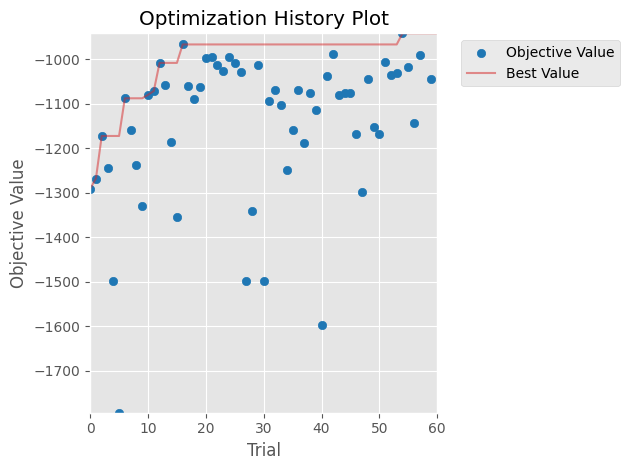

In [ ]:
# --- Plot ----
plot_optimization_history(study)
os.makedirs(drive_optuna_dir, exist_ok=True)
plt.savefig(f"{drive_optuna_dir}/Optimization_History_plot.png")

In [ ]:
print(optuna_saves_dir)
print(drive_optuna_dir)

/tmp/ipython-input-4053187012.py:1: ExperimentalWarning: optuna.visualization.matplotlib._param_importances.plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


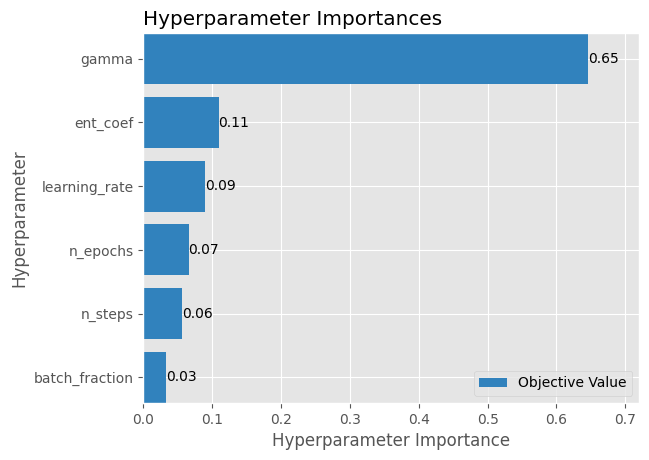

In [ ]:
plot_param_importances(study)
os.makedirs(drive_optuna_dir, exist_ok=True)
plt.savefig(f"{drive_optuna_dir}/Hyperparameter_Importances.png")

# Test

## Baseline sim - Summer

In [ ]:
baseline_env = CityLearnEnv(
    TEST_DATASET,
    central_agent=CENTRAL_AGENT,
    buildings=BUILDINGS_TEST,
    active_observations=ACTIVE_OBSERVATIONS,
    #active_observations=ACTIVE_OBSERVATIONS,
    simulation_start_time_step=TEST_START_TIME_STEP,
    simulation_end_time_step=TEST_END_TIME_STEP,
)


INFO:root:The PV sizing data DNE in cache. Will download from intelligent-environments-lab/CityLearn/tree/v2.2.0 GitHub repository and write to /root/.cache/citylearn/v2.2.0/misc. Next time DataSet.get_pv_sizing_data is called, it will read from cache unless DataSet.clear_cache is run first.
INFO:root:The battery sizing data DNE in cache. Will download from intelligent-environments-lab/CityLearn/tree/v2.2.0 GitHub repository and write to /root/.cache/citylearn/v2.2.0/misc. Next time DataSet.get_battery_sizing_data is called, it will read from cache unless DataSet.clear_cache is run first.


In [ ]:
baseline_model= BaselineAgent(baseline_env)

/usr/local/lib/python3.12/dist-packages/gymnasium/spaces/box.py:236: UserWarning: WARN: Box low's precision lowered by casting to float32, current low.dtype=float64
  gym.logger.warn(
/usr/local/lib/python3.12/dist-packages/gymnasium/spaces/box.py:306: UserWarning: WARN: Box high's precision lowered by casting to float32, current high.dtype=float64
  gym.logger.warn(


In [ ]:
# always start by reseting the environment
observations, _ = baseline_env.reset()
steps = 0
# step through the environment until terminal
# state is reached i.e., the control episode ends
start = time.perf_counter()
while not baseline_env.terminated:
    # select actions from the model
    actions = baseline_model.predict(observations)
    # apply selected actions to the environment
    observations, _, _, _, _ = baseline_env.step(actions)

    steps = steps+1
end = time.perf_counter() - start
print(end)
print(steps)

3.8883826639998915
743


## CityLearn Test



### Model load

In [ ]:
SAVE_FIGS = False

# best_trial = study.best_trial
# trial_number = best_trial.number
# print(f"{EXP_ROOT}/trial_{trial_number}/best_model.zip")
# model = PPO.load(
#     f"{EXP_ROOT}/trial_{trial_number}/best_model.zip",
# )

# --- Plot simulation MBsummary  ---
if SAVE_FIGS == True:
  image_saving_dir = f"{EXP_ROOT}/CityLearnSim"
  os.makedirs(image_saving_dir, exist_ok=True)
  print(image_saving_dir)
else:
  image_saving_dir = None

# ------ This part is for playing

# trial_study = "/trial_"
# trial_model_path = EXP_ROOT + trial_study + "/best_model.zip"
# print(trial_model_path)
# # --- Plot simulation MBsummary  ---
# if SAVE_FIGS == True:
#   image_saving_dir = EXP_ROOT +trial_study+"/CityLearn"
#   os.makedirs(image_saving_dir, exist_ok=True)
# else:
#   image_saving_dir = None


# model = PPO.load(trial_model_path)
# print("MOdel Loaded successfully")

# --------- Finish playing part

/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/CityLearnSim


### Testing part

In [ ]:
BUILDINGS_TEST = sorted(BUILDINGS_TEST)

PPO_test_env = CityLearnEnv(
    buildings = BUILDINGS_TEST,
    schema = TEST_DATASET,
    active_observations=ACTIVE_OBSERVATIONS,
    simulation_start_time_step = TEST_START_TIME_STEP,
    simulation_end_time_step = TEST_END_TIME_STEP,
    central_agent = CENTRAL_AGENT,
    reward_function = CustomReward,
    random_seed = RANDOM_SEED,

)
observations, _ = PPO_test_env.reset()
obs_names = PPO_test_env.observation_names
test_obs_dict = dict(zip(obs_names[0], observations[0]))
print('Observation Dictionary for Testing Env')
import pprint
pprint.pprint(test_obs_dict)

PPO_test_env = NormalizedObservationWrapper(PPO_test_env)

observations, _ = PPO_test_env.reset()
obs_names = PPO_test_env.observation_names
test_obs_dict = dict(zip(obs_names[0], observations[0]))
print('Observation Dictionary for Testing Env - Normalization Warp')
import pprint
pprint.pprint(test_obs_dict)
PPO_test_env = StableBaselines3Wrapper(PPO_test_env)

observations, _ = PPO_test_env.reset()
print("Observations array after SB3 Wrap")
pprint.pprint(observations)


import pprint
pprint.pprint(test_obs_dict)

Observation Dictionary for Testing Env
{'day_type': np.int32(1),
 'electrical_storage_soc': np.float32(0.0),
 'hour': np.int32(1),
 'net_electricity_consumption': np.float32(0.8959),
 'solar_generation': np.float32(0.0)}
Observation Dictionary for Testing Env - Normalization Warp
{'day_type_cos': np.float64(0.8019377358048384),
 'day_type_sin': np.float64(0.9009688679024191),
 'electrical_storage_soc': 0.0,
 'hour_cos': np.float64(0.9829629131445341),
 'hour_sin': np.float64(0.6294095225512604),
 'net_electricity_consumption': np.float32(0.5166834),
 'solar_generation': np.float32(0.0)}
Observations array after SB3 Wrap
array([0.80193776, 0.90096885, 0.9829629 , 0.62940955, 0.        ,
       0.        , 0.47978815, 0.        , 0.        , 0.43254915,
       0.        , 0.        , 0.5613996 , 0.        , 0.        ,
       0.5166834 ], dtype=float32)
{'day_type_cos': np.float64(0.8019377358048384),
 'day_type_sin': np.float64(0.9009688679024191),
 'electrical_storage_soc': 0.0,
 'hour

In [ ]:
print([b.name for b in PPO_test_env.unwrapped.buildings])
print(BUILDINGS_TEST)

['Building_1', 'Building_10', 'Building_13', 'Building_16']
['Building_1', 'Building_10', 'Building_13', 'Building_16']


In [ ]:
building_names = PPO_test_env.unwrapped.buildings
print("Buildings in environment:", building_names)
print("Number of buildings:", len(building_names))

Buildings in environment: [<citylearn.building.Building object at 0x7a4f194092b0>, <citylearn.building.Building object at 0x7a4f18075a60>, <citylearn.building.Building object at 0x7a4f180f03e0>, <citylearn.building.Building object at 0x7a4f193abfe0>]
Number of buildings: 4


In [ ]:
observations, _ = PPO_test_env.reset()
ppo_action_list = []
reward_list = []
counter_steps = 0
verbose = 1

while not PPO_test_env.unwrapped.terminated:

  actions, _ = model_to_train.predict(observations, deterministic = True)
  observations, reward, _, _, _ = PPO_test_env.step(actions)



  ppo_action_list.append(actions)
  reward_list.append(reward)
  counter_steps += 1

  #if counter_steps % 4 == 0 and verbose == 1:
    #print('Reward:',reward)
    #print('Actions:',actions)
    # print(observations)
    # print('Electrical storage soc:', {
    # b.name: b.electrical_storage.soc[b.time_step] for b in PPO_test_env.unwrapped.buildings
    # })
    # print('Net Consumption',{
    # b.name: b.net_electricity_consumption[b.time_step] for b in PPO_test_env.unwrapped.buildings
    # })
    # print('Price',{
    # b.name: b.pricing.electricity_pricing[b.time_step] for b in PPO_test_env.unwrapped.buildings
    # })


print(np.mean(ppo_action_list))
print(np.std(reward_list))


-0.37598515
1.0008621


In [ ]:
# actions_random = []
# action_model = []
# observations, _ = PPO_test_env.reset()

# for _ in range(50):
#   random_action = PPO_test_env.action_space.sample()
#   actions_random.append(random_action)

#   model_action, _ = model.predict(observations, deterministic = True)
#   action_model.append(model_action)

#   observations, reward, terminated, _, _ = PPO_test_env.step(model_action)
#   if terminated:
#     observations, _ = PPO_test_env.reset()

# print("Random actions mean:", np.mean(actions_random))
# print("Random actions std:", np.std(actions_random))
# print("Model actions mean:", np.mean(action_model))
# print("Model actions std:", np.std(action_model))

In [ ]:
print('Electrical storage nominal power:', {
    b.name: b.electrical_storage.nominal_power for b in PPO_test_env.unwrapped.buildings
})

Electrical storage nominal power: {'Building_1': 5.0, 'Building_10': 5.0, 'Building_13': 5.0, 'Building_16': 5.0}


In [ ]:
ppo_action_list

[array([-0.78125, -0.78125, -0.78125, -0.78125], dtype=float32),
 array([-0.78125, -0.78125, -0.78125, -0.78125], dtype=float32),
 array([-0.78125, -0.78125, -0.78125, -0.78125], dtype=float32),
 array([-0.78125  , -0.7541009, -0.78125  , -0.78125  ], dtype=float32),
 array([-0.78125  , -0.5986355, -0.78125  , -0.78125  ], dtype=float32),
 array([-0.78125   , -0.49000123, -0.78125   , -0.78125   ], dtype=float32),
 array([-0.78125   , -0.23475173, -0.78125   , -0.78125   ], dtype=float32),
 array([-0.78125   ,  0.06809796, -0.78125   , -0.78125   ], dtype=float32),
 array([-0.59337956,  0.22975326, -0.5279636 , -0.11559255], dtype=float32),
 array([-0.24821538,  0.2551876 ,  0.02903135,  0.2700042 ], dtype=float32),
 array([-0.17450184,  0.3783919 ,  0.3770334 ,  0.4437023 ], dtype=float32),
 array([-0.1761893 ,  0.62468344,  0.52048856,  0.71682876], dtype=float32),
 array([-0.17244789,  0.78125   ,  0.78125   ,  0.78125   ], dtype=float32),
 array([-0.41902682,  0.78125   ,  0.78125 

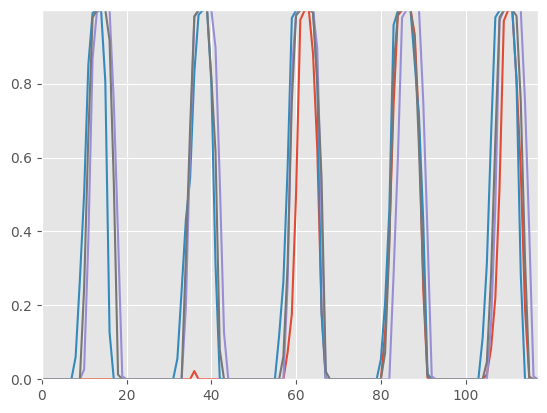

In [ ]:
for ii in range(4):
  plt.plot(PPO_test_env.unwrapped.buildings[ii].electrical_storage.soc[:118])

/tmp/ipython-input-978776159.py:2: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


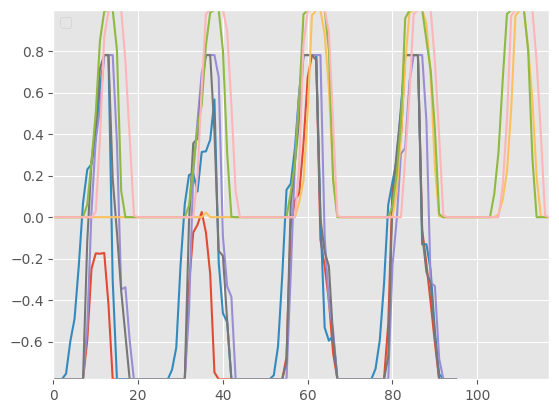

In [ ]:
plt.plot(ppo_action_list[:96])
plt.legend()

for ii in range(3):
  plt.plot(PPO_test_env.unwrapped.buildings[ii].electrical_storage.soc[:118])

In [ ]:
# observations, _ = PPO_test_env.reset()
# actions, _ =  model.predict(observations, deterministic = True)
# print('ACTIONS:',actions)

# observations, reward, terminated, truncated, info = PPO_test_env.step(actions)
# print('OBSERVATIONS:',observations)
# print('Reward:',reward)
# print('Terminated:',terminated)
# print('Truncated:',truncated)
# print('Info:',info)

In [ ]:
# print(ppo_action_list)

# first_elements = [arr[0] for arr in ppo_action_list]
# soc = np.array(PPO_test_env.unwrapped.buildings[0].electrical_storage.soc)

# plt.plot(first_elements)
# plt.plot(soc)
# plt.figure()
# second_elements = [arr[1] for arr in ppo_action_list]
# plt.plot(second_elements, color = 'g')
# soc = np.array(PPO_test_env.unwrapped.buildings[1].electrical_storage.soc)
# plt.plot(soc)



# plt.figure()
# third_elements = [arr[2] for arr in ppo_action_list]
# plt.plot(third_elements, color = 'b')

In [ ]:
# soc = np.array(PPO_test_env.unwrapped.buildings[0].electrical_storage.soc)
# plt.plot(soc)

# plt.figure()
# soc = np.array(PPO_test_env.unwrapped.buildings[1].electrical_storage.soc)
# print(soc)
# plt.plot(soc)

# plt.figure()
# soc = np.array(PPO_test_env.unwrapped.buildings[2].electrical_storage.soc)
# plt.plot(soc)

### Figure

######## BUILDING-LEVEL ########
Building-level KPIs:


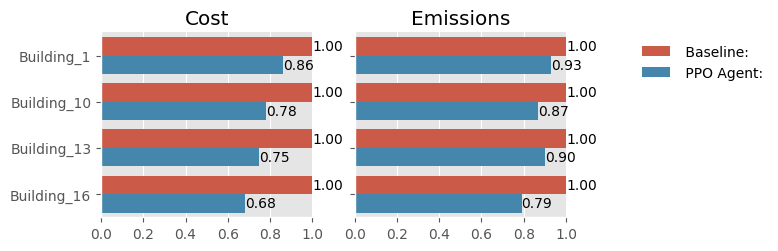

Building-level simulation period load profiles:


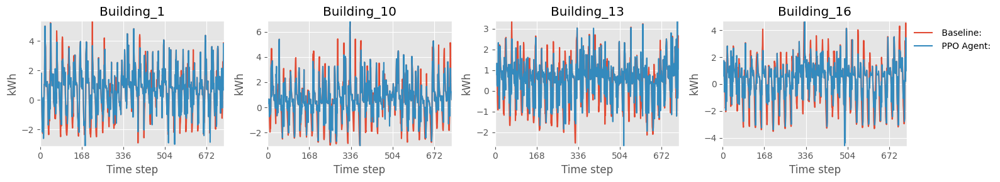

Building-level daily-average load profiles:


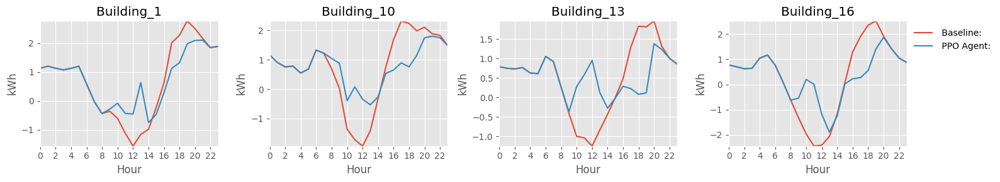

Battery SoC profiles:


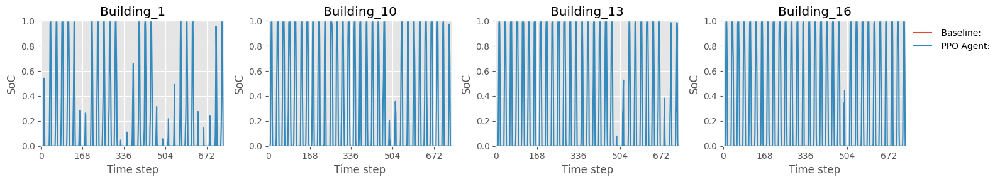

######## DISTRICT-LEVEL ########
District-level KPIs:


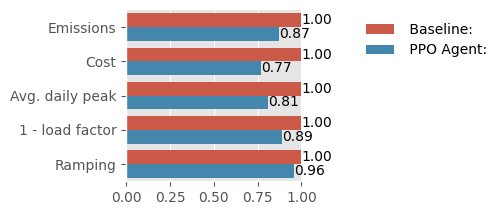

District-level simulation period load profiles:


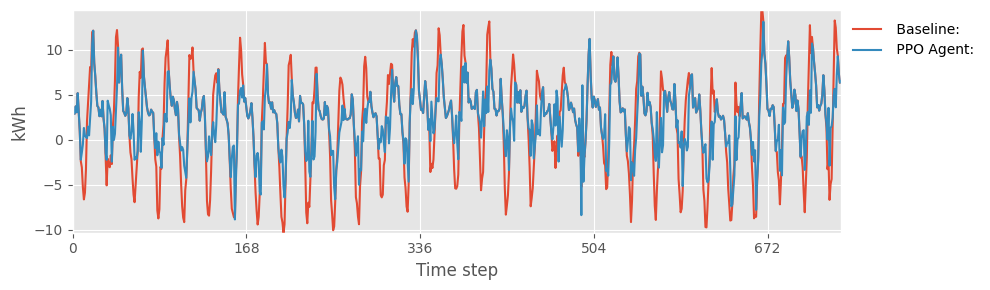

District-level daily-average load profiles:


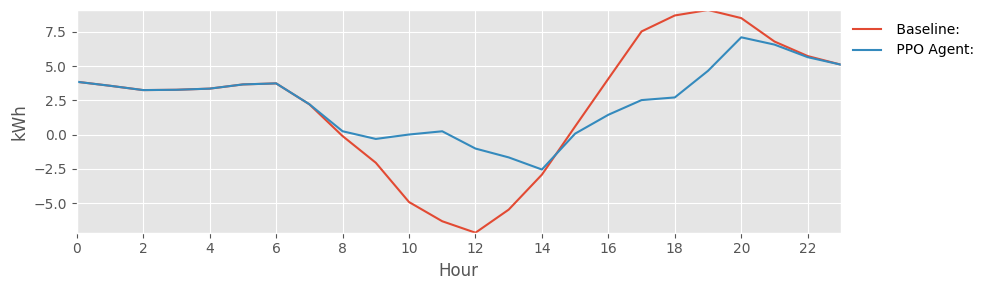

In [ ]:
# --- Plot simulation summary  ---
plot_simulation_summary({
    ' Baseline:' : baseline_env,
    ' PPO Agent:' : PPO_test_env,

},
    save_dir = image_saving_dir)

plt.show()

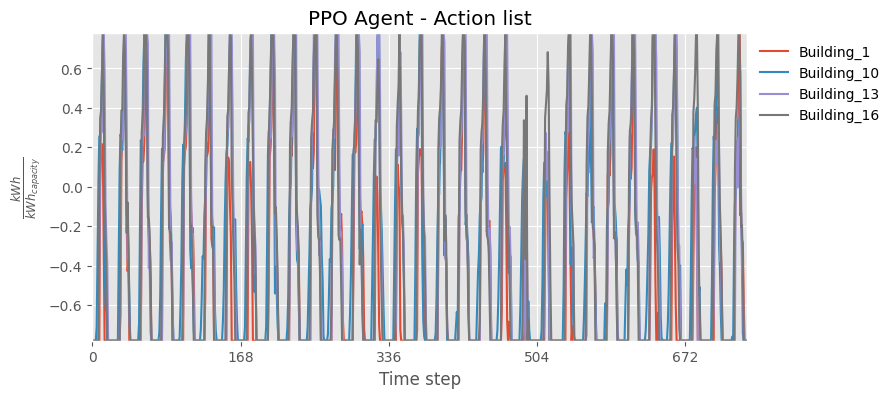

In [ ]:
plot_actions(ppo_action_list, BUILDINGS_TEST, 'PPO Agent - Action list')
if SAVE_FIGS == True:
  plt.savefig(f"{image_saving_dir}/PPO-Agent - Action List.png")


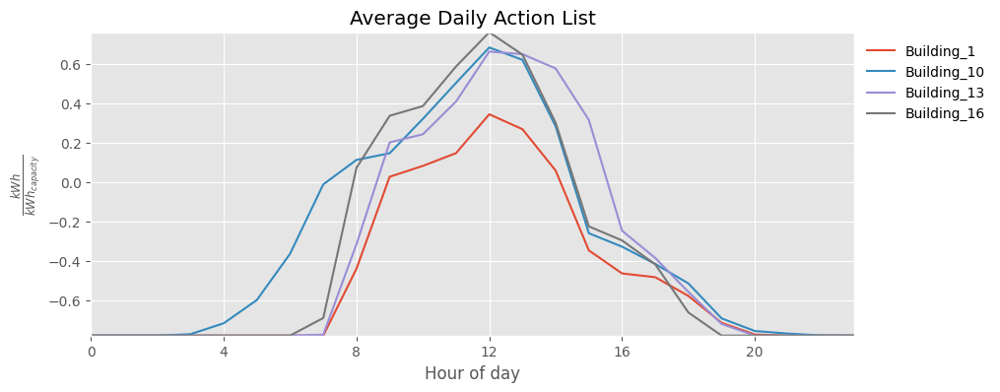

In [ ]:
plot_actions_daily_profile(ppo_action_list, BUILDINGS_TEST, 'Average Daily Action List')

if SAVE_FIGS == True:
  plt.savefig(f"{image_saving_dir}/Average Daily Action List.png")

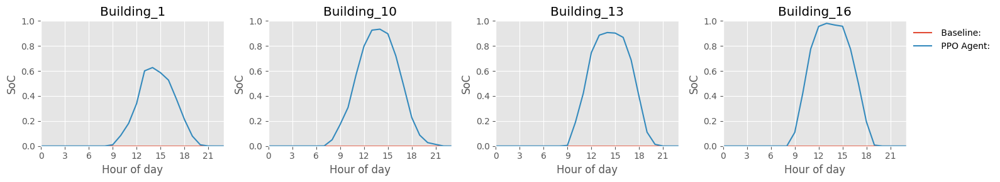

In [ ]:
fig = plot_24h_soc_profiles({
    ' Baseline:' : baseline_env,
    ' PPO Agent:' : PPO_test_env,
})

if SAVE_FIGS == True:
  fig.savefig(f"{image_saving_dir}/24h_SoC_profile.png")


plt.show()